In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.stats import diagnostic
from scipy import stats

import plotly.express as px
import requests
from bs4 import BeautifulSoup
import plotly.offline as pyo
import plotly.graph_objs as go
import plotly.io as py
#Display all columns

pd.set_option('display.max_columns', None)
plt.style.use('ggplot')

%matplotlib inline

Firstly, we decided to work with the data of each website separatly to explore them and determine what's gonna be intersting to work on. 

### RateBeer Website

In [2]:
#RateBeer website data :

df_beer = pd.read_csv("RateBeer/beers.csv", index_col='beer_id')
df_breweries  = pd.read_csv("RateBeer/breweries.csv")
df_users = pd.read_csv("RateBeer/users.csv")


#### Data exploration on df_beer

In [3]:
df_beer

,beer_name,brewery_id,brewery_name,style,nbr_ratings,overall_score,style_score,avg,abv,avg_computed,zscore,nbr_matched_valid_ratings,avg_matched_valid_ratings
beer_id,,,,,,,,,,,,,
410549,33 Export (Gabon),3198,Sobraga,Pale Lager,1,NaN,NaN,2.72,5.0,2.000000,NaN,0,NaN
105273,Castel Beer (Gabon),3198,Sobraga,Pale Lager,10,5.0,58.0,2.18,5.2,1.910000,NaN,0,NaN
19445,Régab,3198,Sobraga,Pale Lager,27,1.0,22.0,1.83,4.5,1.811111,NaN,0,NaN
155699,Ards Bally Black Stout,13538,Ards Brewing Co.,Stout,6,NaN,NaN,3.18,4.6,3.866667,0.823699,6,3.866667
239097,Ards Belfast 366,13538,Ards Brewing Co.,Golden Ale/Blond Ale,1,NaN,NaN,2.79,4.2,3.000000,NaN,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
189684,Stela Selekt,1107,Stefani & Co,Pilsener,5,NaN,NaN,2.19,4.7,1.500000,NaN,0,NaN
84884,Hotel Martini Donauer,9355,Hotel Martini,Pale Lager,1,NaN,NaN,2.77,NaN,2.900000,NaN,0,NaN
93783,Birra Rozafa,9928,Rozafa Brewery,Pale Lager,1,NaN,NaN,2.64,NaN,2.000000,NaN,0,NaN


First we explore the nbr_ratings per beer, the basic descriptive statistics, it's distribution and some visualization. 

In [4]:
df_beer['nbr_ratings'].isna().sum()

0

In [5]:
df_beer['nbr_ratings'].describe(),

(count    442081.000000
 mean         16.110337
 std          80.988812
 min           0.000000
 25%           1.000000
 50%           3.000000
 75%           9.000000
 max        5272.000000
 Name: nbr_ratings, dtype: float64,)

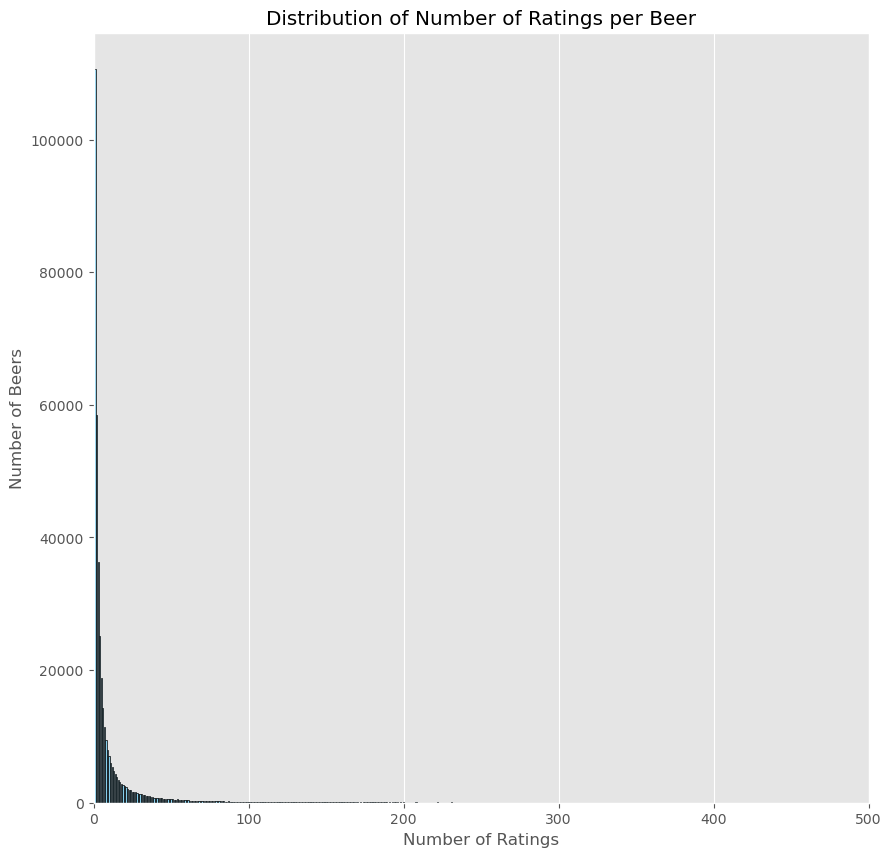

In [6]:
# Count the number of beers for each number of ratings
reviews_counts = df_beer['nbr_ratings'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Ratings')
plt.ylabel('Number of Beers')
plt.title('Distribution of Number of Ratings per Beer')
plt.grid(axis='y')
plt.xlim(0, 500)
plt.show()


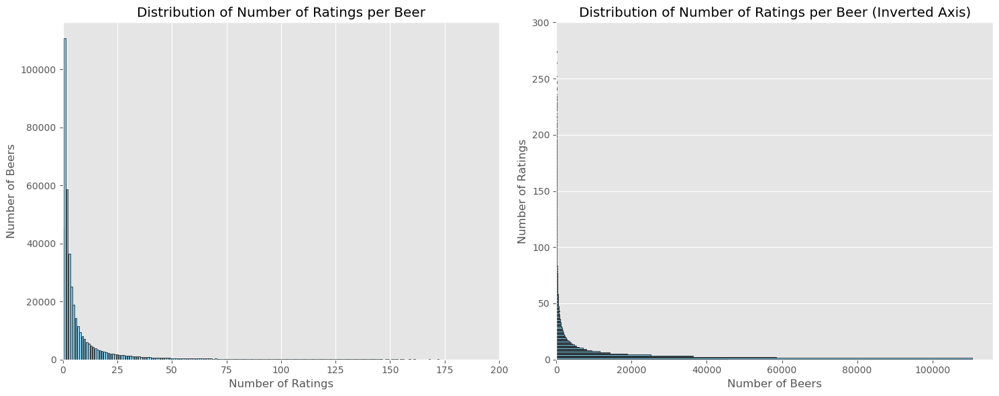

In [7]:
# Count the number of beers for each number of ratings
reviews_counts = df_beer['nbr_ratings'].value_counts().sort_index()

# Create a figure with two subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

# Plot 1: Original axis
axes[0].bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
axes[0].set_xlabel('Number of Ratings')
axes[0].set_ylabel('Number of Beers')
axes[0].set_title('Distribution of Number of Ratings per Beer')
axes[0].grid(axis='y')


# Plot 2: Inverted axis
axes[1].barh(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
axes[1].set_xlabel('Number of Beers')
axes[1].set_ylabel('Number of Ratings')
axes[1].set_title('Distribution of Number of Ratings per Beer (Inverted Axis)')
axes[1].grid(axis='x')


axes[1].set_ylim(0, 300) 
axes[0].set_xlim(0, 200) 

plt.tight_layout() 
plt.show()


In [8]:
# Get an idea of the distribution of the number of ratings per beer

# Choose different quantile thresholds 
ratings_threshold75 = df_beer['nbr_ratings'].quantile(0.75)
ratings_threshold90 = df_beer['nbr_ratings'].quantile(0.90)
ratings_threshold95 = df_beer['nbr_ratings'].quantile(0.95)
ratings_threshold98 = df_beer['nbr_ratings'].quantile(0.98)
ratings_threshold99 = df_beer['nbr_ratings'].quantile(0.99)

# Filter beers based on the threshold
filtered_beers75 = df_beer[df_beer['nbr_ratings'] >= ratings_threshold75]
filtered_beers90 = df_beer[df_beer['nbr_ratings'] >= ratings_threshold90]
filtered_beers95 = df_beer[df_beer['nbr_ratings'] >= ratings_threshold95]
filtered_beers98 = df_beer[df_beer['nbr_ratings'] >= ratings_threshold98]
filtered_beers99 = df_beer[df_beer['nbr_ratings'] >= ratings_threshold99]

print(filtered_beers75.shape,
filtered_beers90.shape,
filtered_beers95.shape,
filtered_beers98.shape,
filtered_beers99.shape)

(112028, 13) (44752, 13) (22228, 13) (8914, 13) (4428, 13)


Note: we see that even by taking the top 1% of most rated beers we still have 4428 beers. 

In [9]:
# Create a new DataFrame with beers in the 99th percentile
df_filtered_beer = filtered_beers99

# Display the new DataFrame
display(df_filtered_beer)

,beer_name,brewery_id,brewery_name,style,nbr_ratings,overall_score,style_score,avg,abv,avg_computed,zscore,nbr_matched_valid_ratings,avg_matched_valid_ratings
beer_id,,,,,,,,,,,,,
3126,Tiger Beer,547,Singapore Brewery (Asia Pacific Breweries-Hein...,Pale Lager,1556,5.0,50.0,2.13,5.0,2.138560,NaN,0,NaN
51355,Lucky Beer (Lucky Buddha),11483,Cheerday Hangzhou Qiandaohu Beer Co.,Pale Lager,595,2.0,31.0,1.92,4.8,1.943361,NaN,0,NaN
17334,Harbin Beer,2951,Harbin Beer Company (AB InBev),Pale Lager,318,3.0,40.0,2.01,4.8,2.009119,NaN,0,NaN
730,Tsingtao,116,Tsingtao Brewery,Pale Lager,2031,3.0,42.0,2.03,4.8,2.045790,NaN,0,NaN
47351,Timișoreana,2300,Ursus Breweries (SABMiller),Pale Lager,290,6.0,69.0,2.26,5.0,2.285862,NaN,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2549,Zlatý Baant (12% / Golden Pheasant / Premium),443,Heineken Slovensko,Czech Pilsner (Světlý),904,15.0,29.0,2.68,5.0,2.685509,NaN,0,NaN
11012,Kenya Tusker Lager,1521,Kenya Breweries (EABL/East African Breweries -...,Pale Lager,1085,5.0,52.0,2.14,4.2,2.155115,NaN,0,NaN
17078,Leo Beer,178,Boon Rawd Brewery,Pale Lager,282,1.0,19.0,1.80,5.0,1.878369,NaN,0,NaN


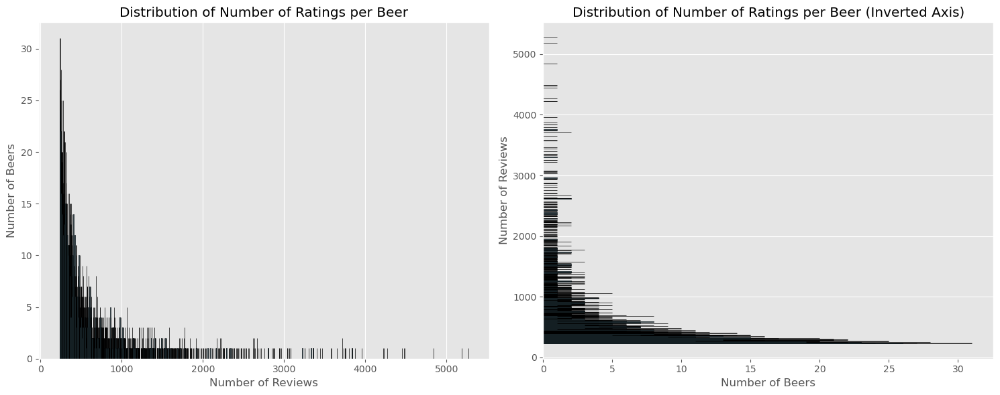

In [10]:
# Count the number of beers for each number of ratings
reviews_counts = df_filtered_beer['nbr_ratings'].value_counts().sort_index()

# Create a figure with two subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

# Plot 1: Original axis
axes[0].bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
axes[0].set_xlabel('Number of Reviews')
axes[0].set_ylabel('Number of Beers')
axes[0].set_title('Distribution of Number of Ratings per Beer')
axes[0].grid(axis='y')

#SUPPRES SECOND PLOT (EVERYWHERE) 

# Plot 2: Inverted axis
axes[1].barh(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
axes[1].set_xlabel('Number of Beers')
axes[1].set_ylabel('Number of Reviews')
axes[1].set_title('Distribution of Number of Ratings per Beer (Inverted Axis)')
axes[1].grid(axis='x')


plt.tight_layout()  # Adjust subplot parameters for better layout
plt.show()


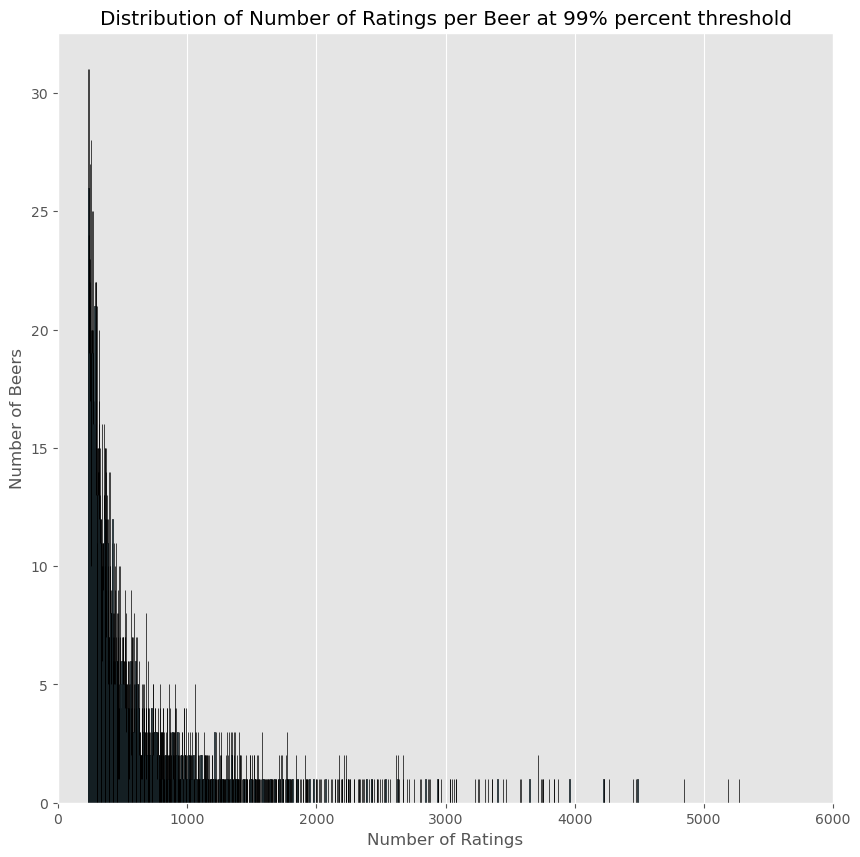

In [11]:
# Count the number of beers for each number of ratings
reviews_counts = df_filtered_beer['nbr_ratings'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Ratings')
plt.ylabel('Number of Beers')
plt.title('Distribution of Number of Ratings per Beer at 99% percent threshold')
plt.grid(axis='y')
plt.xlim(0,6000)
plt.show()

In [12]:
df_filtered_beer['nbr_ratings'].describe(),

(count    4428.000000
 mean      586.780036
 std       521.992411
 min       232.000000
 25%       291.000000
 50%       396.000000
 75%       657.000000
 max      5272.000000
 Name: nbr_ratings, dtype: float64,)

In [13]:
df_filtered_beer.loc[df_filtered_beer['nbr_ratings'].idxmin()]


beer_name                                    Lvivske Porter
brewery_id                                             3078
brewery_name                 Lvivska Pivovarnya (Carlsberg)
style                                         Baltic Porter
nbr_ratings                                             232
overall_score                                          82.0
style_score                                            48.0
avg                                                    3.43
abv                                                     8.0
avg_computed                                       3.450431
zscore                                                  NaN
nbr_matched_valid_ratings                                 0
avg_matched_valid_ratings                               NaN
Name: 25805, dtype: object

In [14]:
df_filtered_beer.loc[df_filtered_beer['nbr_ratings'].idxmax()]


beer_name                    Rochefort Trappistes 10
brewery_id                                       406
brewery_name                     Brasserie Rochefort
style                                  Abt/Quadrupel
nbr_ratings                                     5272
overall_score                                  100.0
style_score                                    100.0
avg                                             4.29
abv                                             11.3
avg_computed                                4.319917
zscore                                      1.590864
nbr_matched_valid_ratings                       5270
avg_matched_valid_ratings                   4.320114
Name: 2360, dtype: object

Gives us an idea of the distribution of the most rated beers (nbr_ratings) and the maximum/minimum nbr_ratings of the top 1% most rated beer 

Next we explore the zscore per beer, the basic descriptive statistics, it's distribution and some visualization. Will allow us later, when we recompute the new z-scores with the most active reviewer to compare them. 

In [15]:
df_beer = df_beer[df_beer['zscore'] != 0].copy()
df_beer['zscore'].describe()
# If we compare these results with the one we would have got with the original DataFrame. 

count    42228.000000
mean        -0.104638
std          0.732841
min         -5.460346
25%         -0.479561
50%         -0.023696
75%          0.364636
max          2.941123
Name: zscore, dtype: float64

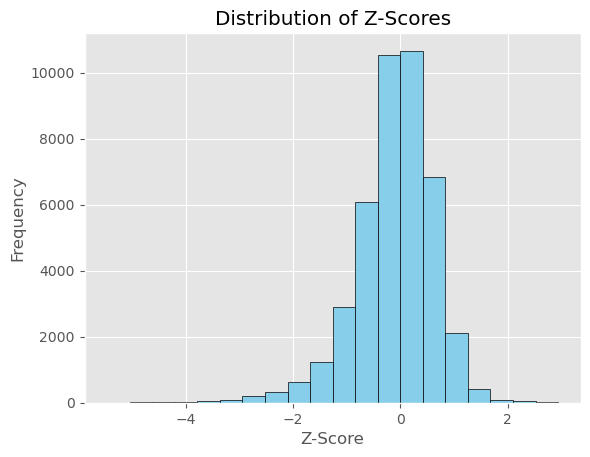

In [16]:
# Visualize the z-score distribution 

plt.hist(df_beer['zscore'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Z-Score')
plt.ylabel('Frequency')
plt.title('Distribution of Z-Scores')
plt.show()

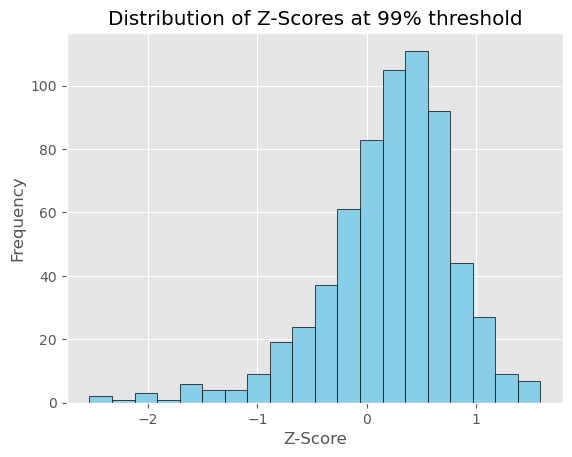

In [17]:
# Visualize the z-score distribution at 99% threshold 

plt.hist(df_filtered_beer['zscore'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Z-Score')
plt.ylabel('Frequency')
plt.title('Distribution of Z-Scores at 99% threshold')
plt.show()

We can notice that for beers with nbr_ratings > 232 (the minimum number of ratings for the top 1% most rated beer) the z-score spreads less. 

In [18]:
# METTRE CES PLOTS DE COTES 

In [19]:
# Plot the z-score for each beer in function of the number of ratings
fig_zscore_vs_nbr_ratings_RB = px.scatter(df_beer, x='zscore', y='nbr_ratings', color='zscore')
#fig_zscore_vs_nbr_ratings_RB.update_layout(title='Z-Score vs Number of Ratings') #----> we remove the title because it's nicer to add them directly in the website
fig_zscore_vs_nbr_ratings_RB.update_traces(showlegend=False)
fig_zscore_vs_nbr_ratings_RB.show()



In [20]:
# Plot the z-score for each beer in function of the number of ratings
fig_zscore_vs_nbr_ratings_RB = px.scatter(df_filtered_beer, x='zscore', y='nbr_ratings', color='zscore')
#fig_zscore_vs_nbr_ratings_RB.update_layout(title='Z-Score vs Number of Ratings') #----> we remove the title because it's nicer to add them directly in the website
fig_zscore_vs_nbr_ratings_RB.update_traces(showlegend=False)
fig_zscore_vs_nbr_ratings_RB.show()

#Save the plot in html format
pyo.plot(fig_zscore_vs_nbr_ratings_RB, filename='zscore_vs_nbr_ratings_RB_99.html')


'zscore_vs_nbr_ratings_RB_99.html'

Here we explore the overall_score per beer, the basic descriptive statistics, it's distribution and some visualization. 

In [21]:
df_beer

,beer_name,brewery_id,brewery_name,style,nbr_ratings,overall_score,style_score,avg,abv,avg_computed,zscore,nbr_matched_valid_ratings,avg_matched_valid_ratings
beer_id,,,,,,,,,,,,,
410549,33 Export (Gabon),3198,Sobraga,Pale Lager,1,NaN,NaN,2.72,5.0,2.000000,NaN,0,NaN
105273,Castel Beer (Gabon),3198,Sobraga,Pale Lager,10,5.0,58.0,2.18,5.2,1.910000,NaN,0,NaN
19445,Régab,3198,Sobraga,Pale Lager,27,1.0,22.0,1.83,4.5,1.811111,NaN,0,NaN
155699,Ards Bally Black Stout,13538,Ards Brewing Co.,Stout,6,NaN,NaN,3.18,4.6,3.866667,0.823699,6,3.866667
239097,Ards Belfast 366,13538,Ards Brewing Co.,Golden Ale/Blond Ale,1,NaN,NaN,2.79,4.2,3.000000,NaN,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
189684,Stela Selekt,1107,Stefani & Co,Pilsener,5,NaN,NaN,2.19,4.7,1.500000,NaN,0,NaN
84884,Hotel Martini Donauer,9355,Hotel Martini,Pale Lager,1,NaN,NaN,2.77,NaN,2.900000,NaN,0,NaN
93783,Birra Rozafa,9928,Rozafa Brewery,Pale Lager,1,NaN,NaN,2.64,NaN,2.000000,NaN,0,NaN


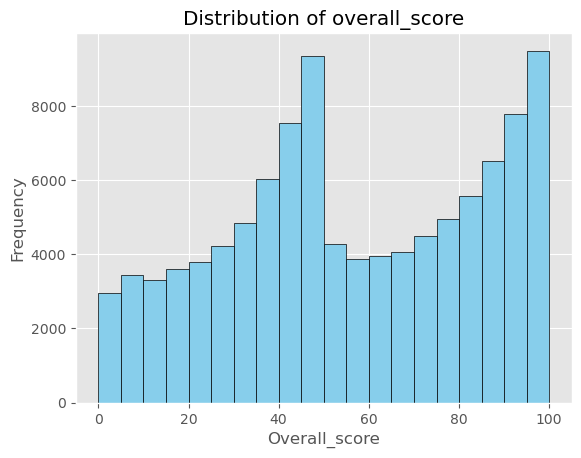

In [22]:
# Visualize the overall_score distribution 

plt.hist(df_beer['overall_score'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Overall_score')
plt.ylabel('Frequency')
plt.title('Distribution of overall_score')
plt.show()

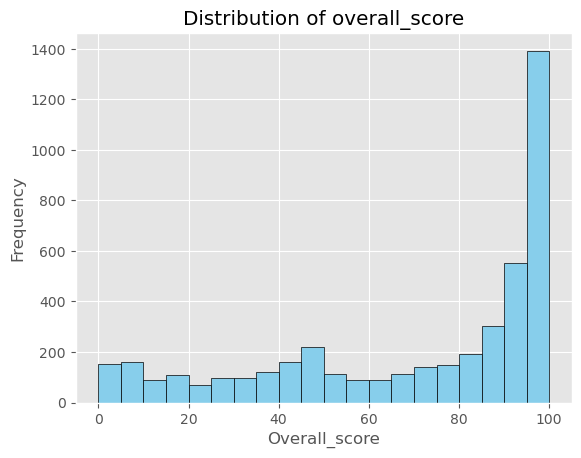

In [23]:
# Visualize the overall_score distribution at 99% threshold 

plt.hist(df_filtered_beer['overall_score'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Overall_score')
plt.ylabel('Frequency')
plt.title('Distribution of overall_score')
plt.show()

Note: The frequency of beers with low overall_score gets lower when having more ratings (as the second plot shows only the top 1% most rated beers). Shows that when we restrain the number of users...

#### Data exploration on df_user

In [24]:
df_users

,nbr_ratings,user_id,user_name,joined,location
0,1890,175852,Manslow,1.337508e+09,Poland
1,89,442761,MAGICuenca91,1.484046e+09,Spain
2,169,288889,Sibarh,1.384600e+09,Poland
3,3371,250510,fombe89,1.363950e+09,Spain
4,13043,122778,kevnic2008,1.296644e+09,Germany
...,...,...,...,...,...
70169,1,134893,stamfordbus,1.315217e+09,England
70170,1,327816,fobia405,1.406282e+09,Belgium
70171,1,183139,junkin,1.339841e+09,NaN
70172,3,82020,klesidra,1.222250e+09,Slovenia


First we explore the nbr_ratings per users, the basic descriptive statistics, it's distribution and some visualization. 

In [25]:
df_users['nbr_ratings'].isna().sum()


0

In [26]:
df_users['nbr_ratings'].describe()

count    70174.000000
mean       108.820945
std        754.493211
min          1.000000
25%          1.000000
50%          2.000000
75%         10.000000
max      46749.000000
Name: nbr_ratings, dtype: float64

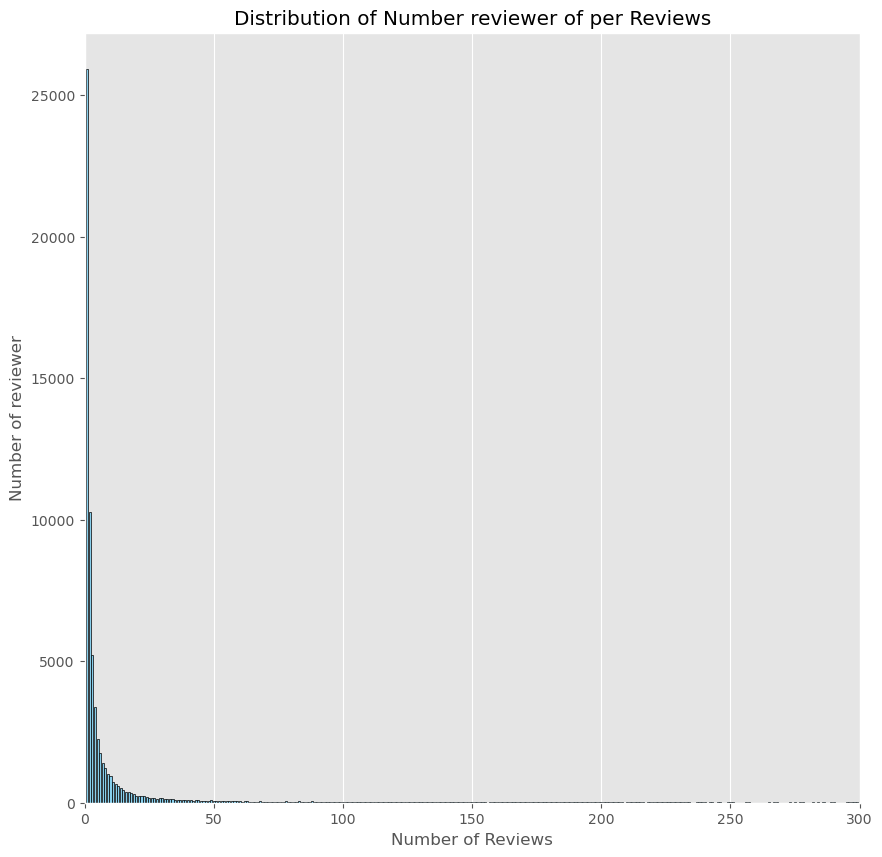

In [27]:
# Count the number of beers for each number of ratings
reviews_counts = df_users['nbr_ratings'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Reviews')
plt.ylabel('Number of reviewer')
plt.title('Distribution of Number reviewer of per Reviews')
plt.grid(axis='y')
plt.xlim(0,300)
plt.show()

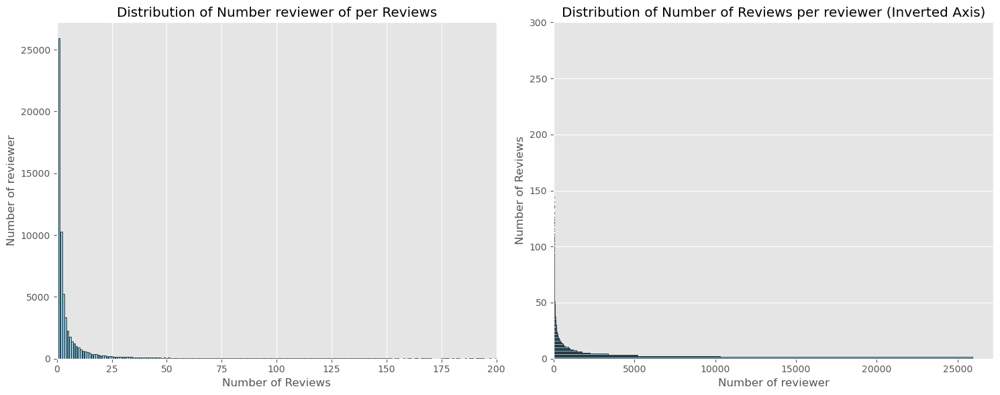

In [28]:
# Count the number of beers for each number of reviews
reviews_counts = df_users['nbr_ratings'].value_counts().sort_index()

# Create a figure with two subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

# Plot 1: Original axis
axes[0].bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
axes[0].set_xlabel('Number of Reviews')
axes[0].set_ylabel('Number of reviewer')
axes[0].set_title('Distribution of Number reviewer of per Reviews')
axes[0].grid(axis='y')

# Plot 2: Inverted axis
axes[1].barh(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
axes[1].set_xlabel('Number of reviewer')
axes[1].set_ylabel('Number of Reviews')
axes[1].set_title('Distribution of Number of Reviews per reviewer (Inverted Axis)')
axes[1].grid(axis='x')


axes[1].set_ylim(0, 300) 
axes[0].set_xlim(0, 200) 

plt.tight_layout()  
plt.show()


In [29]:
# Choose a percentile threshold (adjust as needed)
ratings_threshold75 = df_users['nbr_ratings'].quantile(0.75)
ratings_threshold90 = df_users['nbr_ratings'].quantile(0.90)
ratings_threshold95 = df_users['nbr_ratings'].quantile(0.95)
ratings_threshold98 = df_users['nbr_ratings'].quantile(0.98)
ratings_threshold99 = df_users['nbr_ratings'].quantile(0.99)

# Filter beers based on the threshold
filtered_users75 = df_users[df_users['nbr_ratings'] >= ratings_threshold75]
filtered_users90 = df_users[df_users['nbr_ratings'] >= ratings_threshold90]
filtered_users95 = df_users[df_users['nbr_ratings'] >= ratings_threshold95]
filtered_users98 = df_users[df_users['nbr_ratings'] >= ratings_threshold98]
filtered_users99 = df_users[df_users['nbr_ratings'] >= ratings_threshold99]

print(filtered_users75.shape,
filtered_users90.shape,
filtered_users95.shape,
filtered_users98.shape,
filtered_users99.shape)

(17744, 5) (7037, 5) (3518, 5) (1404, 5) (702, 5)


We have 702 at the top 1% of nbr_ratings. 

In [30]:
# Create a new DataFrame with beers in the 99th percentile
df_filtered_users = filtered_users99

# Display the new DataFrame
display(df_filtered_users)

,nbr_ratings,user_id,user_name,joined,location
3,3371,250510,fombe89,1.363950e+09,Spain
4,13043,122778,kevnic2008,1.296644e+09,Germany
5,21024,227834,Beerhunter111,1.352718e+09,Germany
6,8781,83106,Erzengel,1.224324e+09,Germany
7,4051,37316,Lowenbrau,1.147860e+09,Spain
...,...,...,...,...,...
8992,3038,114741,Reynolds314,1.286359e+09,"United States, Connecticut"
10064,2652,68527,baraciisch,1.201432e+09,"United States, California"
10567,5031,78749,BoBoChamp,1.216462e+09,Belgium
10772,2543,44516,islay,1.162552e+09,"United States, Minnesota"


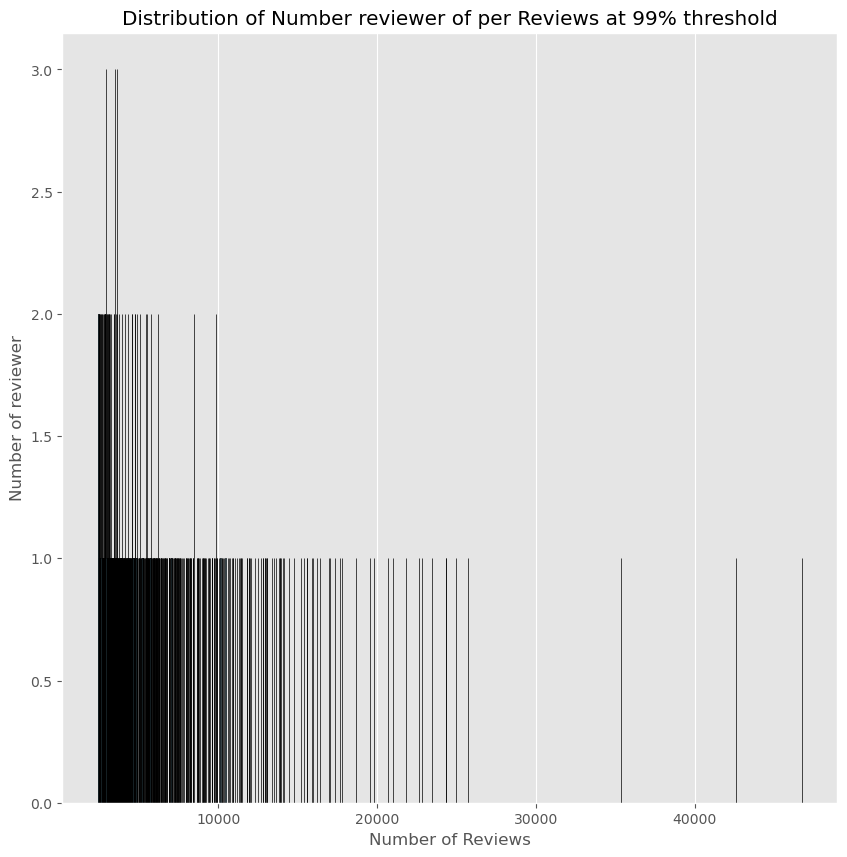

In [31]:
# Count the number of beers for each number of ratings
reviews_counts = df_filtered_users['nbr_ratings'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Reviews')
plt.ylabel('Number of reviewer')
plt.title('Distribution of Number reviewer of per Reviews at 99% threshold')
plt.grid(axis='y')
plt.show()

In [32]:
df_filtered_users.loc[df_filtered_users['nbr_ratings'].idxmin()]


nbr_ratings                       2406
user_id                         221043
user_name                     DCLawyer
joined                    1349431200.0
location       United States, Virginia
Name: 1754, dtype: object

In [33]:
df_filtered_users.loc[df_filtered_users['nbr_ratings'].idxmax()]

nbr_ratings           46749
user_id               38926
user_name           fonefan
joined         1150970400.0
location            Denmark
Name: 16, dtype: object

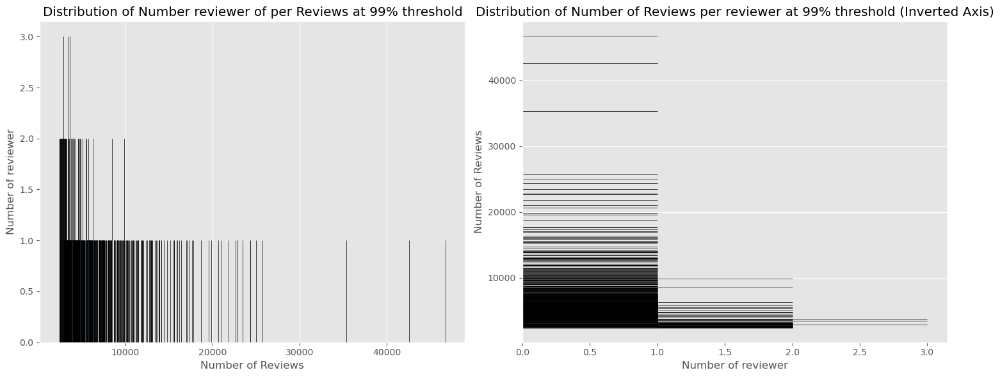

In [34]:
# Count the number of beers for each number of reviews
reviews_counts = df_filtered_users['nbr_ratings'].value_counts().sort_index()

# Create a figure with two subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

# Plot 1: Original axis
axes[0].bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
axes[0].set_xlabel('Number of Reviews')
axes[0].set_ylabel('Number of reviewer')
axes[0].set_title('Distribution of Number reviewer of per Reviews at 99% threshold')
axes[0].grid(axis='y')

# Plot 2: Inverted axis
axes[1].barh(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
axes[1].set_xlabel('Number of reviewer')
axes[1].set_ylabel('Number of Reviews')
axes[1].set_title('Distribution of Number of Reviews per reviewer at 99% threshold (Inverted Axis)')
axes[1].grid(axis='x')


plt.tight_layout()  
plt.show()

Next, we explore the location, the basic descriptive statistics, it's distribution and some visualization. 

In [35]:
# Raw data
print(df_users['location'].value_counts().sort_values(ascending=False))
# Threshold at top 1% users
print(df_filtered_users['location'].value_counts().sort_values(ascending=False))


Canada                         3255
United States, California      2804
England                        2734
Poland                         1701
United States, Pennsylvania    1632
                               ... 
Jamaica                           1
North Korea                       1
Nagorno-Karabakh                  1
French Guiana                     1
Tibet                             1
Name: location, Length: 222, dtype: int64
Canada                          54
Denmark                         51
England                         48
Sweden                          36
Netherlands                     33
                                ..
United States, West Virginia     1
Moldova                          1
United States, Delaware          1
Czech Republic                   1
United States, Maine             1
Name: location, Length: 78, dtype: int64


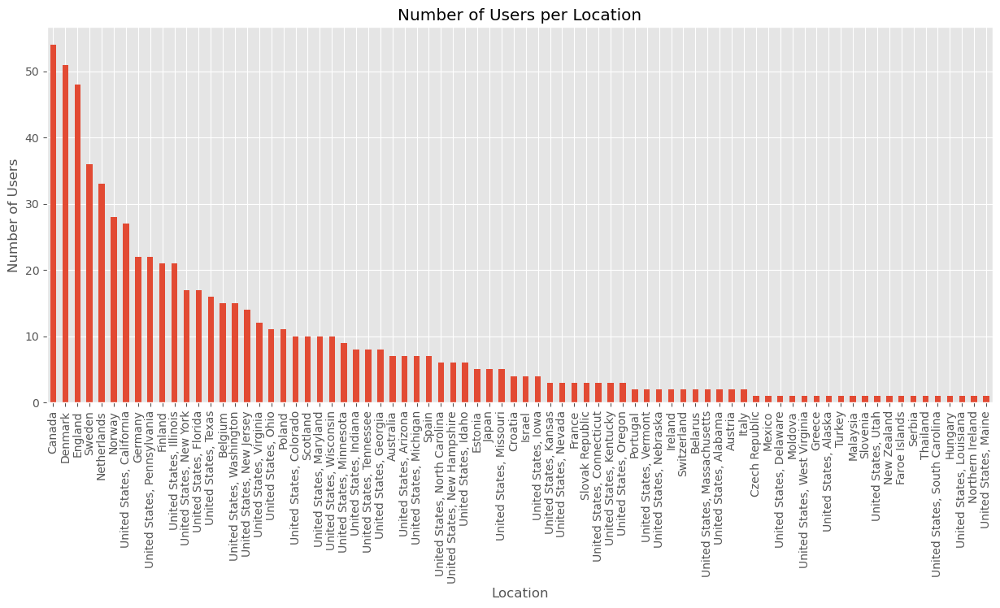

In [36]:
# plot the number of users per location att 99% threshold

df_filtered_users['location'].value_counts().plot(kind='bar', figsize=(15,6))
plt.xlabel('Location')
plt.ylabel('Number of Users')
plt.title('Number of Users per Location')
plt.show()


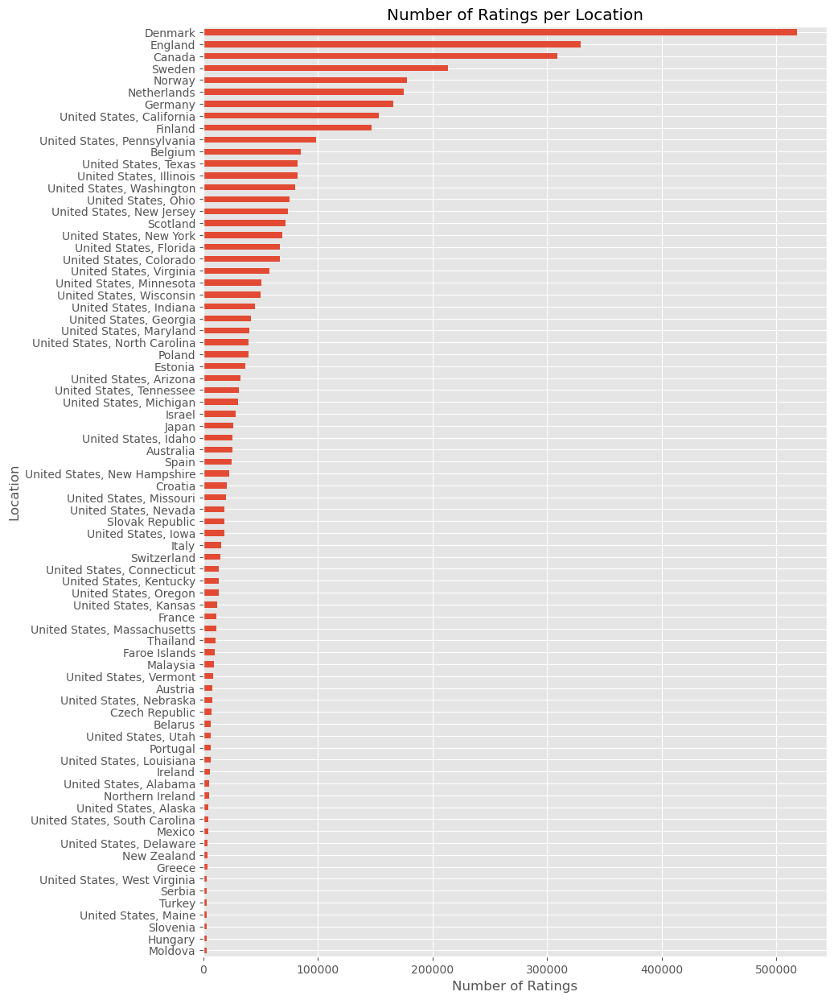

In [37]:
# plot the number of ratings per location att 99% threshold 

df_filtered_users.groupby('location')['nbr_ratings'].sum().sort_values().plot(kind='barh', figsize=(10, 15))
plt.xlabel('Number of Ratings')
plt.ylabel('Location')
plt.title('Number of Ratings per Location')
plt.show()

### BeerAdvocate website

In [38]:
df_beer_BA = pd.read_csv("BeerAdvocate/beers.csv", index_col='beer_id')
df_breweries_BA  = pd.read_csv("BeerAdvocate/breweries.csv")
df_users_BA = pd.read_csv("BEerAdvocate/users.csv")

In [39]:
df_beer_BA

,beer_name,brewery_id,brewery_name,style,nbr_ratings,nbr_reviews,avg,ba_score,bros_score,abv,avg_computed,zscore,nbr_matched_valid_ratings,avg_matched_valid_ratings
beer_id,,,,,,,,,,,,,,
166064,Nashe Moskovskoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,4.7,NaN,NaN,0,NaN
166065,Nashe Pivovskoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,3.8,NaN,NaN,0,NaN
166066,Nashe Shakhterskoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,4.8,NaN,NaN,0,NaN
166067,Nashe Zhigulevskoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,4.0,NaN,NaN,0,NaN
166063,Zhivoe,39912,Abdysh-Ata (Абдыш Ата),Euro Pale Lager,0,0,NaN,NaN,NaN,4.5,NaN,NaN,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,Kölsch,3,3,2.71,NaN,NaN,5.0,2.713333,NaN,0,NaN
19140,Nut Brown Ale,885,Summit Station Restaurant & Brewery,English Brown Ale,2,1,3.10,NaN,NaN,5.3,3.250000,NaN,0,NaN
19146,Octoberfest,885,Summit Station Restaurant & Brewery,Märzen / Oktoberfest,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN


In [40]:
df_users_BA

,nbr_ratings,nbr_reviews,user_id,user_name,joined,location
0,7820,465,nmann08.184925,nmann08,1.199704e+09,"United States, Washington"
1,2521,2504,stjamesgate.163714,StJamesGate,1.191838e+09,"United States, New York"
2,1797,1143,mdagnew.19527,mdagnew,1.116410e+09,Northern Ireland
3,31,31,helloloser12345.10867,helloloser12345,1.101380e+09,Northern Ireland
4,604,604,cypressbob.3708,cypressbob,1.069326e+09,Northern Ireland
...,...,...,...,...,...,...
153699,1,1,everman.532342,Everman,1.291115e+09,"United States, California"
153700,1,1,justin0001.352175,Justin0001,1.248343e+09,"United States, California"
153701,1,0,kyungsup.982216,Kyungsup,1.430561e+09,NaN
153702,1,1,joetex.800347,JoeTex,1.400234e+09,"United States, California"


#### Data exploration on df_beer_BA

In [41]:
# keep in mind that we also have bros_score, so potentialy we could use it to filter the data and only keep the users which are not bros.
# so the same with the bros (try to look where they are compared to the others)

In [42]:
df_beer_BA['nbr_ratings'].describe()

count    280823.000000
mean         29.887267
std         231.010063
min           0.000000
25%           1.000000
50%           2.000000
75%           8.000000
max       16509.000000
Name: nbr_ratings, dtype: float64

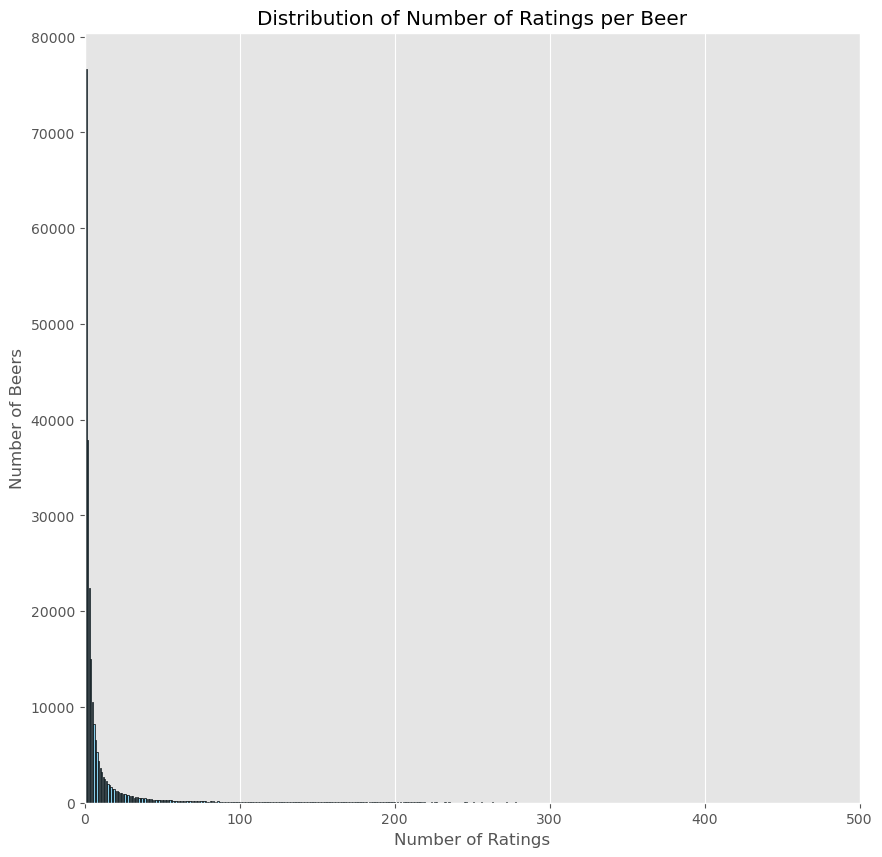

In [43]:
# Count the number of beers for each number of ratings
reviews_counts = df_beer_BA['nbr_ratings'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Ratings')
plt.ylabel('Number of Beers')
plt.title('Distribution of Number of Ratings per Beer')
plt.grid(axis='y')
plt.xlim(0, 500)
plt.show()

In [44]:
# Get an idea of the distribution of the number of ratings per beer

# Choose different quantile thresholds 
ratings_threshold75_BA = df_beer_BA['nbr_ratings'].quantile(0.75)
ratings_threshold90_BA = df_beer_BA['nbr_ratings'].quantile(0.90)
ratings_threshold95_BA = df_beer_BA['nbr_ratings'].quantile(0.95)
ratings_threshold98_BA = df_beer_BA['nbr_ratings'].quantile(0.98)
ratings_threshold99_BA = df_beer_BA['nbr_ratings'].quantile(0.99)

# Filter beers based on the threshold
filtered_beers75_BA = df_beer_BA[df_beer_BA['nbr_ratings'] >= ratings_threshold75_BA]
filtered_beers90_BA = df_beer_BA[df_beer_BA['nbr_ratings'] >= ratings_threshold90_BA]
filtered_beers95_BA = df_beer_BA[df_beer_BA['nbr_ratings'] >= ratings_threshold95_BA]
filtered_beers98_BA = df_beer_BA[df_beer_BA['nbr_ratings'] >= ratings_threshold98_BA]
filtered_beers99_BA = df_beer_BA[df_beer_BA['nbr_ratings'] >= ratings_threshold99_BA]

print(filtered_beers75_BA.shape,
filtered_beers90_BA.shape,
filtered_beers95_BA.shape,
filtered_beers98_BA.shape,
filtered_beers99_BA.shape)

(70860, 14) (28177, 14) (14086, 14) (5631, 14) (2814, 14)


Note: we see that even by taking the top 1% of most rated beers we still have 2814 beers. If we compare this results to the one found in RateBeer, we have 63.55% of the nbr_ratings for the top 1% rated beer.

In [45]:
# Create a new DataFrame with beers in the 99th percentile
df_filtered_beer_BA = filtered_beers99_BA

# Display the new DataFrame
display(df_filtered_beer_BA)

,beer_name,brewery_id,brewery_name,style,nbr_ratings,nbr_reviews,avg,ba_score,bros_score,abv,avg_computed,zscore,nbr_matched_valid_ratings,avg_matched_valid_ratings
beer_id,,,,,,,,,,,,,,
41037,Ola Dubh Special Reserve 12,323,Harviestoun Brewery Ltd.,Old Ale,834,383,4.13,92.0,NaN,8.0,4.114868,NaN,0,NaN
41012,Ola Dubh Special Reserve 16,323,Harviestoun Brewery Ltd.,Old Ale,628,297,4.12,91.0,NaN,8.0,4.126433,NaN,0,NaN
875,Old Engine Oil Black Ale,323,Harviestoun Brewery Ltd.,English Porter,1736,812,4.10,91.0,100.0,6.0,4.135737,NaN,0,NaN
12719,Innis And Gunn Original Oak Aged Beer,10272,Innis & Gunn,Scottish Ale,1775,571,3.75,85.0,81.0,6.6,3.740062,NaN,0,NaN
77595,Irish Whiskey Aged Scottish Stout,10272,Innis & Gunn,English Stout,672,177,3.81,86.0,NaN,7.4,3.818557,NaN,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57088,Fluffy White Rabbits,18371,Pretty Things Beer & Ale Project,Tripel,630,187,4.03,90.0,NaN,8.5,4.019238,NaN,0,NaN
46290,Jack D'Or,18371,Pretty Things Beer & Ale Project,Saison / Farmhouse Ale,1640,642,4.01,90.0,96.0,6.5,4.036098,NaN,0,NaN
82753,Meadowlark IPA,18371,Pretty Things Beer & Ale Project,American IPA,792,133,4.10,91.0,NaN,7.0,4.076174,NaN,0,NaN


In [46]:
# Plot the z-score for each beer in function of the number of ratings
fig_zscore_vs_nbr_ratings_BA = px.scatter(df_filtered_beer_BA, x='zscore', y='nbr_ratings', color='zscore')
#fig_zscore_vs_nbr_ratings_BA.update_layout(title='Z-Score vs Number of Ratings') #----> we remove the title because it's nicer to add them directly in the website
fig_zscore_vs_nbr_ratings_BA.update_traces(showlegend=False)
fig_zscore_vs_nbr_ratings_BA.show()

#Save the plot in html format
pyo.plot(fig_zscore_vs_nbr_ratings_BA, filename='zscore_vs_nbr_ratings_BA_99.html')

'zscore_vs_nbr_ratings_BA_99.html'

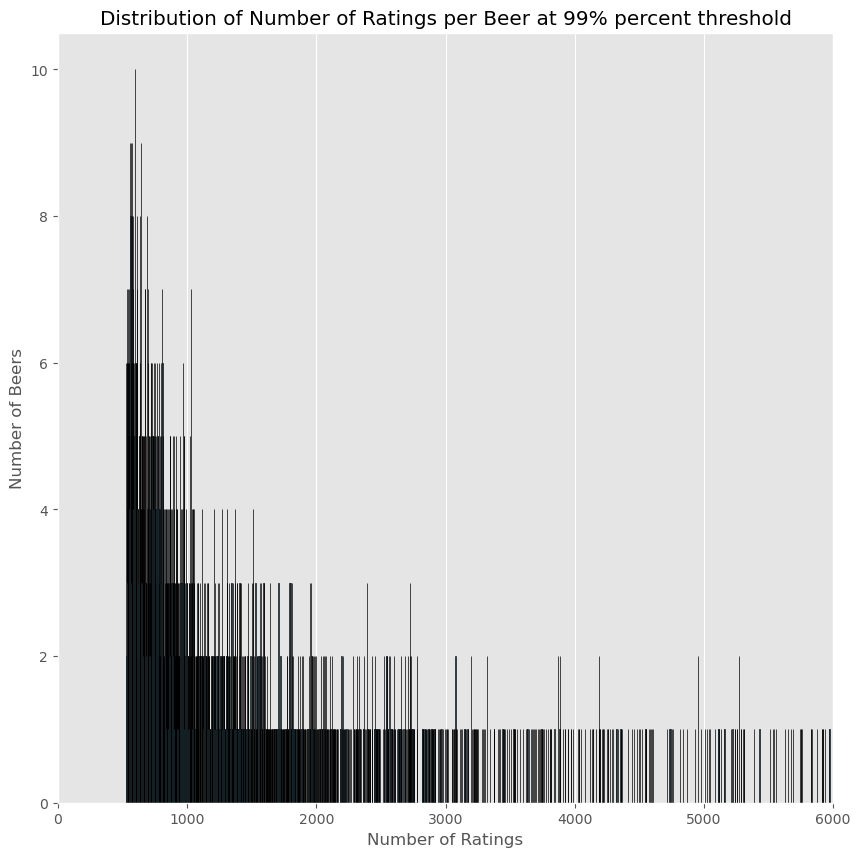

In [47]:
# Count the number of beers for each number of ratings
reviews_counts = df_filtered_beer_BA['nbr_ratings'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Ratings')
plt.ylabel('Number of Beers')
plt.title('Distribution of Number of Ratings per Beer at 99% percent threshold')
plt.grid(axis='y')
plt.xlim(0,6000)
plt.show()

In [48]:
print(df_filtered_beer_BA.loc[df_filtered_beer_BA['nbr_ratings'].idxmax()]
,df_filtered_beer_BA.loc[df_filtered_beer_BA['nbr_ratings'].idxmin()])

beer_name                            Founders Breakfast Stout
brewery_id                                               1199
brewery_name                         Founders Brewing Company
style                        American Double / Imperial Stout
nbr_ratings                                             16509
nbr_reviews                                              3811
avg                                                      4.47
ba_score                                                 99.0
bros_score                                              100.0
abv                                                       8.3
avg_computed                                          4.51376
zscore                                                    NaN
nbr_matched_valid_ratings                                   0
avg_matched_valid_ratings                                 NaN
Name: 11757, dtype: object beer_name                                      Jaipur IPA
brewery_id                                     

Gives us an idea of the distribution of the most rated beers (nbr_ratings) and the maximum/minimum nbr_ratings of the top 1% most rated beer. Despite having less beer in the top 1% than in RateBeer they have more ratings (minimum 529 here vs 232 in RateBeer). 

Next we explore the zscore per beer, the basic descriptive statistics, it's distribution and some visualization. Will allow us later, when we recompute the new z-scores with the most active reviewer to compare them. 

In [49]:
df_beer_BA = df_beer_BA[df_beer_BA['zscore'] != 0].copy()
df_beer_BA['zscore'].describe()

count    40285.000000
mean        -0.408295
std          0.806491
min         -6.655704
25%         -0.785424
50%         -0.321596
75%          0.086733
max          2.211576
Name: zscore, dtype: float64

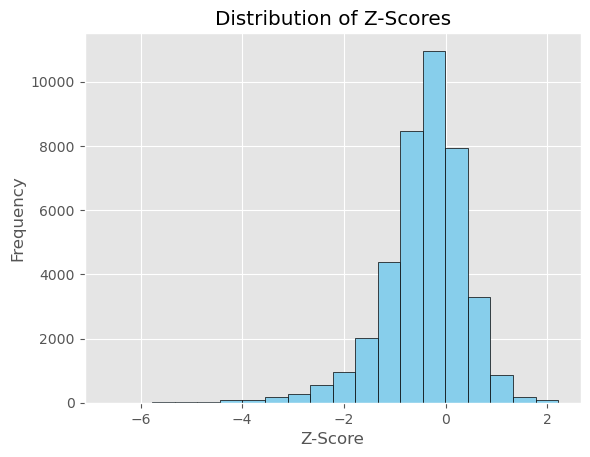

In [50]:
# Visualize the z-score distribution 

plt.hist(df_beer_BA['zscore'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Z-Score')
plt.ylabel('Frequency')
plt.title('Distribution of Z-Scores')
plt.show()

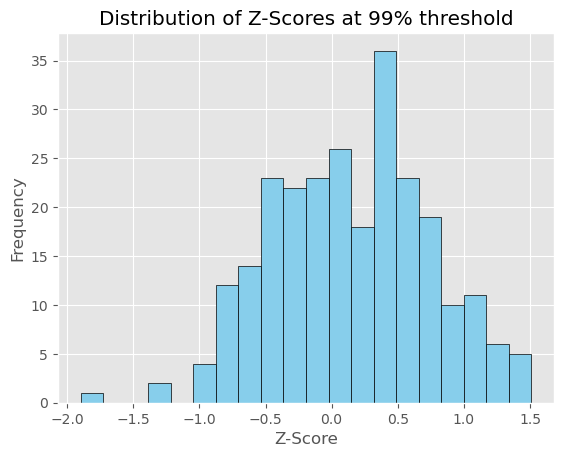

In [51]:
# Visualize the z-score distribution at 99% threshold 

plt.hist(df_filtered_beer_BA['zscore'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Z-Score')
plt.ylabel('Frequency')
plt.title('Distribution of Z-Scores at 99% threshold')
plt.show()

We can notice that for beers with nbr_ratings > 529 (the minimum number of ratings for the top 1% most rated beer) the z-score spreads less (and more than for RateBeer as we have more nbr_ratings per beer). 

Here we explore the overall_score per beer, the basic descriptive statistics, it's distribution and some visualization. 

In [52]:
df_beer_BA = df_beer_BA[df_beer_BA['ba_score'] != 0].copy()
print(df_beer_BA['ba_score'].describe())

count    61200.000000
mean        84.633284
std          4.052723
min         46.000000
25%         83.000000
50%         85.000000
75%         86.000000
max        100.000000
Name: ba_score, dtype: float64


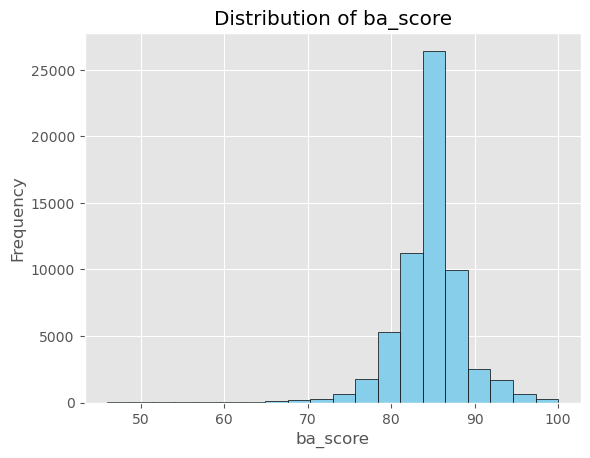

In [53]:
# Visualize the z-score distribution 

plt.hist(df_beer_BA['ba_score'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('ba_score')
plt.ylabel('Frequency')
plt.title('Distribution of ba_score')
plt.show()

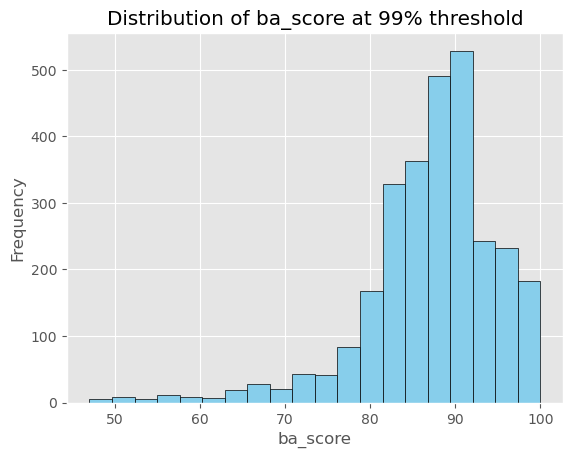

In [54]:
# Visualize the z-score distribution at 99% threshold 

plt.hist(df_filtered_beer_BA['ba_score'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('ba_score')
plt.ylabel('Frequency')
plt.title('Distribution of ba_score at 99% threshold')
plt.show()

Note: The mean ba_score of beers shifts to the right when having more ratings (as the second plot shows only the top 1% most rated beers). Shows that when we restrain the number of users...

### Data exploration on df_user_BA

In [55]:
df_users_BA['nbr_ratings'].describe()


count    153704.000000
mean         54.605163
std         252.388790
min           1.000000
25%           1.000000
50%           3.000000
75%          16.000000
max       12046.000000
Name: nbr_ratings, dtype: float64

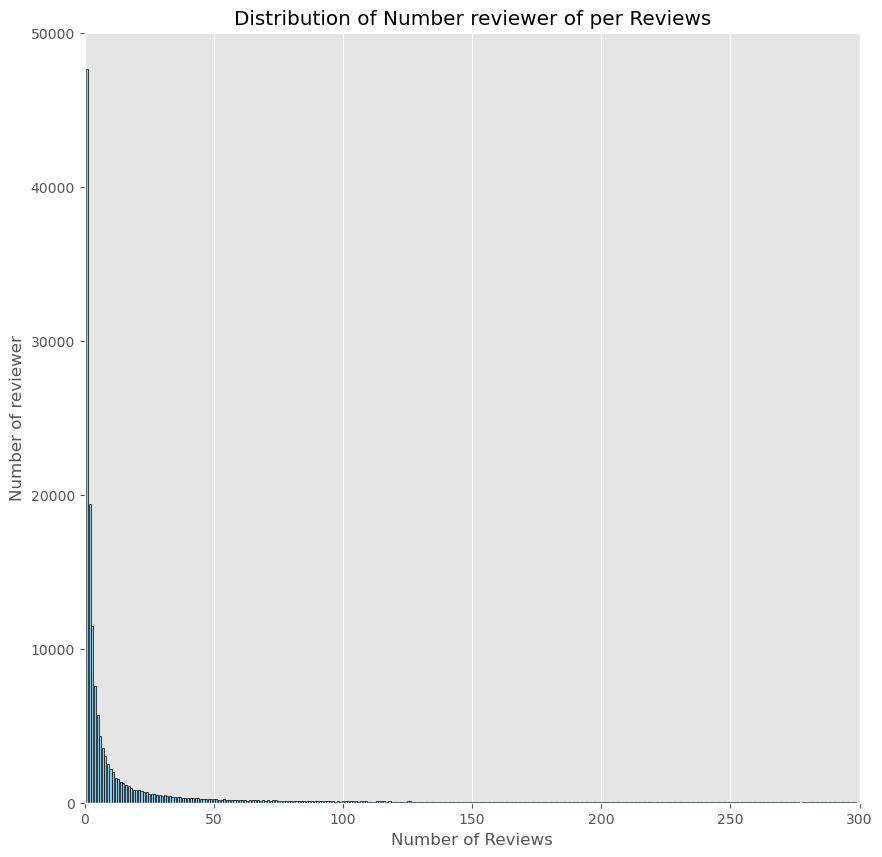

In [56]:
# Count the number of beers for each number of ratings
reviews_counts = df_users_BA['nbr_ratings'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Reviews')
plt.ylabel('Number of reviewer')
plt.title('Distribution of Number reviewer of per Reviews')
plt.grid(axis='y')
plt.xlim(0,300)
plt.show()

In [57]:
# Get an idea of the distribution of the number of ratings per beer

# Choose different quantile thresholds 
ratings_threshold75_BA = df_users_BA['nbr_ratings'].quantile(0.75)
ratings_threshold90_BA = df_users_BA['nbr_ratings'].quantile(0.90)
ratings_threshold95_BA = df_users_BA['nbr_ratings'].quantile(0.95)
ratings_threshold98_BA = df_users_BA['nbr_ratings'].quantile(0.98)
ratings_threshold99_BA = df_users_BA['nbr_ratings'].quantile(0.99)

# Filter beers based on the threshold
filtered_users75_BA = df_users_BA[df_users_BA['nbr_ratings'] >= ratings_threshold75_BA]
filtered_users90_BA = df_users_BA[df_users_BA['nbr_ratings'] >= ratings_threshold90_BA]
filtered_users95_BA = df_users_BA[df_users_BA['nbr_ratings'] >= ratings_threshold95_BA]
filtered_users98_BA = df_users_BA[df_users_BA['nbr_ratings'] >= ratings_threshold98_BA]
filtered_users99_BA = df_users_BA[df_users_BA['nbr_ratings'] >= ratings_threshold99_BA]

print(filtered_beers75_BA.shape,
filtered_users90_BA.shape,
filtered_users95_BA.shape,
filtered_users98_BA.shape,
filtered_users99_BA.shape)

(70860, 14) (15415, 6) (7708, 6) (3075, 6) (1542, 6)


We have 1542 users at the top 1% of nbr_ratings. 

In [58]:
# Create a new DataFrame with beers in the 99th percentile
df_filtered_users_BA = filtered_users99_BA

# Display the new DataFrame
display(df_filtered_users_BA)

,nbr_ratings,nbr_reviews,user_id,user_name,joined,location
0,7820,465,nmann08.184925,nmann08,1.199704e+09,"United States, Washington"
1,2521,2504,stjamesgate.163714,StJamesGate,1.191838e+09,"United States, New York"
2,1797,1143,mdagnew.19527,mdagnew,1.116410e+09,Northern Ireland
5,2326,0,hellpop65.48993,Hellpop65,1.131966e+09,"United States, Kansas"
6,3098,0,latarnik.52897,Latarnik,1.133521e+09,"United States, New Jersey"
...,...,...,...,...,...,...
30610,1331,0,italianstallion.788089,italianstallion,1.394622e+09,"United States, Wisconsin"
32690,1261,1017,ri0.683063,Ri0,1.341137e+09,"United States, Wisconsin"
32760,1219,5,xdtfx.691499,xdtfx,1.346062e+09,"United States, Illinois"
40813,1039,542,mikeward.620428,MikeWard,1.315994e+09,"United States, Pennsylvania"


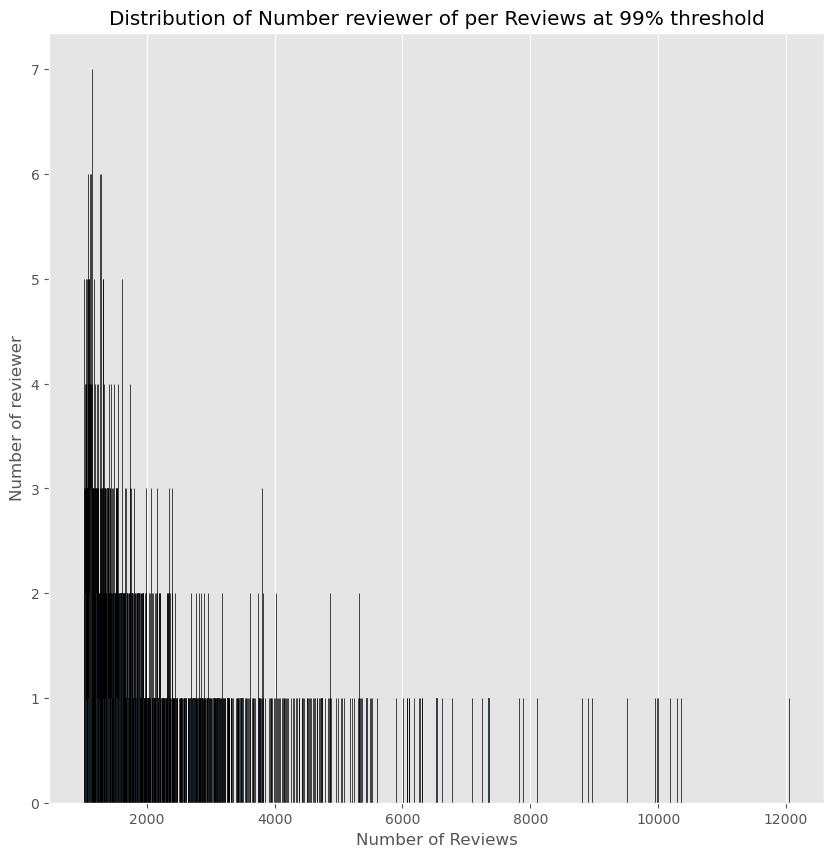

In [59]:
# Count the number of beers for each number of ratings
reviews_counts = df_filtered_users_BA['nbr_ratings'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Reviews')
plt.ylabel('Number of reviewer')
plt.title('Distribution of Number reviewer of per Reviews at 99% threshold')
plt.grid(axis='y')
plt.show()

In [60]:
df_filtered_users_BA.loc[df_filtered_users_BA['nbr_ratings'].idxmax()]

nbr_ratings           12046
nbr_reviews            7593
user_id          sammy.3853
user_name             Sammy
joined         1070276400.0
location             Canada
Name: 228, dtype: object

In [61]:
df_filtered_users_BA.loc[df_filtered_users_BA['nbr_ratings'].idxmin()]

nbr_ratings                       1023
nbr_reviews                         71
user_id             stampfler07.154141
user_name                  stampfler07
joined                    1187604000.0
location       United States, Colorado
Name: 586, dtype: object

In [62]:
# On peut aussi faire sur les locations mais flemme et surtout y'as pas d'interet pour ce tour du monde. 

#### MatchedBeer data

Here we show that we can not work with the Matched_beer data frames as they only take into account the users with ratings of BeerAdvocate and RateBeer, thus we ommit a significative part of the most active users in each site. 

In [63]:
pd.set_option('display.max_columns', None)
df_users_matched = pd.read_csv("matched_beer_data/users.csv", header=1)
df_users_matched

,joined,location,nbr_ratings,nbr_reviews,user_id,user_name,user_name_lower,joined.1,location.1,nbr_ratings.1,user_id.1,user_name.1,user_name_lower.1
0,1.220868e+09,Germany,6,6,erzengel.248045,Erzengel,erzengel,1.224324e+09,Germany,8781,83106,Erzengel,erzengel
1,1.348394e+09,"United States, Virginia",1,1,gendv138.695700,GenDV138,gendv138,1.385723e+09,"United States, Virginia",6240,290599,GenDV138,gendv138
2,1.207303e+09,"United States, Washington",3,3,nimbleprop.208928,nimbleprop,nimbleprop,1.150798e+09,"United States, Washington",7452,38859,nimbleprop,nimbleprop
3,1.322737e+09,Estonia,11,0,visionthing.639993,visionthing,visionthing,1.242986e+09,Estonia,5462,91324,visionthing,visionthing
4,1.432116e+09,England,1,0,lazypyro.989356,LazyPyro,lazypyro,1.431166e+09,England,1096,368991,LazyPyro,lazypyro
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3015,1.253182e+09,"United States, Pennsylvania",398,398,shadesofgray.371155,ShadesOfGray,shadesofgray,1.261998e+09,"United States, Pennsylvania",1,99346,ShadesOfGray,shadesofgray
3016,1.095847e+09,"United States, Michigan",587,587,ypsifly.8833,ypsifly,ypsifly,1.139569e+09,"United States, Michigan",1,33393,ypsifly,ypsifly
3017,1.047121e+09,"United States, Texas",1379,1379,hardtarget.1712,HardTarget,hardtarget,1.095934e+09,"United States, Texas",1,15553,HardTarget,hardtarget
3018,1.416740e+09,Vietnam,176,24,nelsonsaigon.897449,nelsonsaigon,nelsonsaigon,1.406369e+09,Vietnam,1,327965,nelsonsaigon,nelsonsaigon


In [64]:
# Only taking the part of the data frame which comes from RateBeer 
df_users_matched = df_users_matched.loc[:, 'location.1':'user_name_lower.1']
df_users_matched

,location.1,nbr_ratings.1,user_id.1,user_name.1,user_name_lower.1
0,Germany,8781,83106,Erzengel,erzengel
1,"United States, Virginia",6240,290599,GenDV138,gendv138
2,"United States, Washington",7452,38859,nimbleprop,nimbleprop
3,Estonia,5462,91324,visionthing,visionthing
4,England,1096,368991,LazyPyro,lazypyro
...,...,...,...,...,...
3015,"United States, Pennsylvania",1,99346,ShadesOfGray,shadesofgray
3016,"United States, Michigan",1,33393,ypsifly,ypsifly
3017,"United States, Texas",1,15553,HardTarget,hardtarget
3018,Vietnam,1,327965,nelsonsaigon,nelsonsaigon


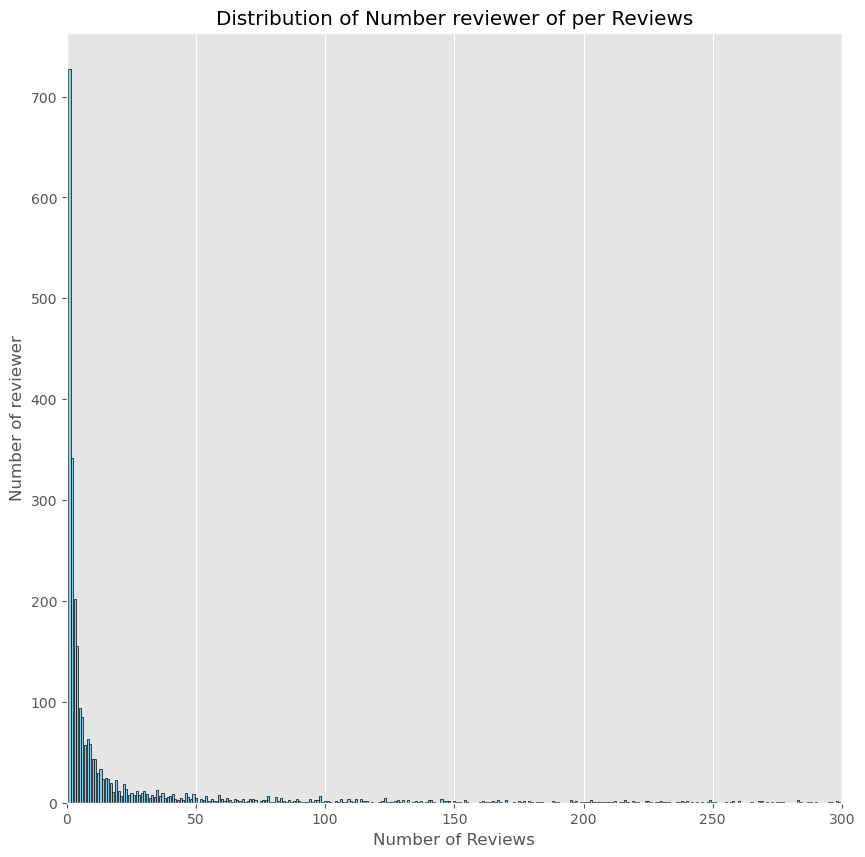

In [65]:
# Count the number of beers for each number of ratings
reviews_counts = df_users_matched['nbr_ratings.1'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Reviews')
plt.ylabel('Number of reviewer')
plt.title('Distribution of Number reviewer of per Reviews')
plt.grid(axis='y')
plt.xlim(0,300)
plt.show()

In [66]:
ratings_threshold99_matched = df_users_matched['nbr_ratings.1'].quantile(0.99)
filtered_users99_matched = df_users_matched[df_users_matched['nbr_ratings.1'] >= ratings_threshold99_matched]

filtered_users99_matched.shape

(31, 5)

We have 31 users at the top 1% of nbr_ratings. 

In [67]:
filtered_users99_matched

,location.1,nbr_ratings.1,user_id.1,user_name.1,user_name_lower.1
0,Germany,8781,83106,Erzengel,erzengel
1,"United States, Virginia",6240,290599,GenDV138,gendv138
2,"United States, Washington",7452,38859,nimbleprop,nimbleprop
5,Finland,6403,98624,tiong,tiong
6,Finland,11275,82173,rosenbergh,rosenbergh
8,Germany,20678,17095,Koelschtrinker,koelschtrinker
9,England,19568,74136,Leighton,leighton
11,Netherlands,13082,111648,kermis,kermis
13,Switzerland,11810,181,Bov,bov
15,"United States, Michigan",7835,87165,arminjewell,arminjewell


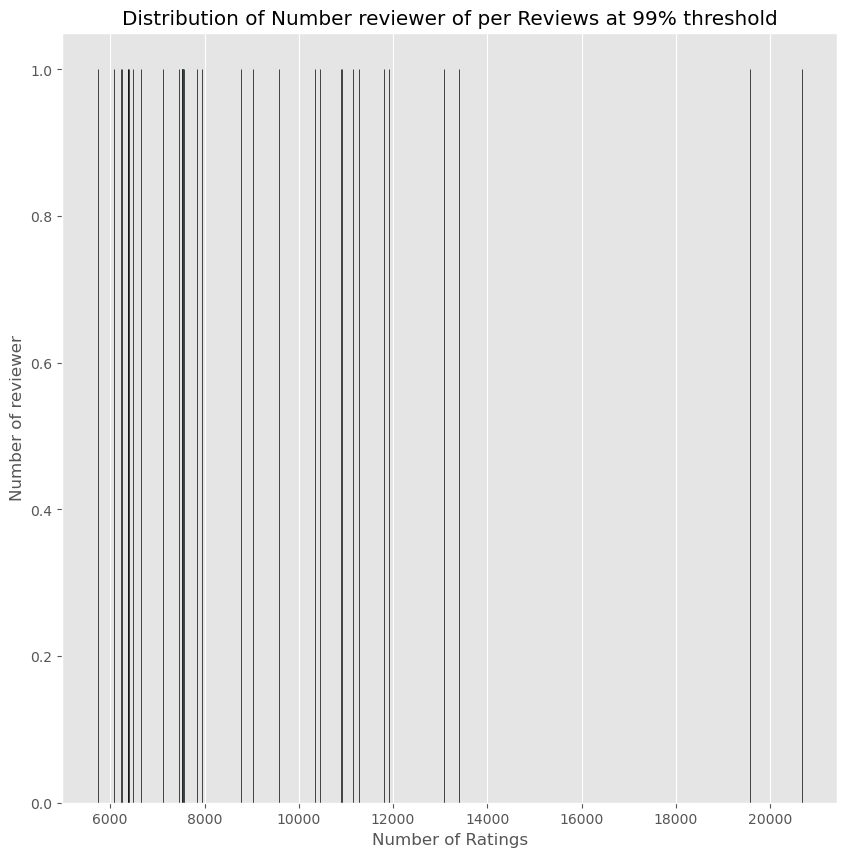

In [68]:
# Count the number of beers for each number of ratings
reviews_counts = filtered_users99_matched['nbr_ratings.1'].value_counts().sort_index()

# Plot the distribution of number of ratings per beer
plt.figure(figsize=(10,10))
plt.bar(reviews_counts.index, reviews_counts.values, color='skyblue', edgecolor='black')
plt.xlabel('Number of Ratings')
plt.ylabel('Number of reviewer')
plt.title('Distribution of Number reviewer of per Reviews at 99% threshold')
plt.grid(axis='y')
plt.show()

In [69]:
filtered_users99_matched.loc[filtered_users99_matched['nbr_ratings.1'].idxmax()]

location.1                  Germany
nbr_ratings.1                 20678
user_id.1                     17095
user_name.1          Koelschtrinker
user_name_lower.1    koelschtrinker
Name: 8, dtype: object

In [70]:
filtered_users99_matched.loc[filtered_users99_matched['nbr_ratings.1'].idxmin()]

location.1           Netherlands
nbr_ratings.1               5733
user_id.1                 285335
user_name.1               Maakun
user_name_lower.1         maakun
Name: 67, dtype: object

on peut aussi regarder ou se trouve ce user dans RateBeer user pour voir environ ou il est ou meme regarder ou ces 31
users se trouvent dans RateBeer (meme chose pour BeerAdvocate). C'est les memes users qui commentes les deux donc juste utiliser la 
data frame au dessus (la filtered user) et faire avec ca tema la proportion et si les plus actifs sont compris dedans. 

In [71]:
print(df_filtered_users[df_filtered_users['user_id'] == 17095])


     nbr_ratings  user_id       user_name        joined location
101        20678    17095  Koelschtrinker  1.100257e+09  Germany


In [72]:
df_filtered_users_ranked = df_filtered_users.sort_values('nbr_ratings', ascending=False)
df_filtered_users_ranked

,nbr_ratings,user_id,user_name,joined,location
16,46749,38926,fonefan,1.150970e+09,Denmark
54,42567,30149,yespr,1.132398e+09,Denmark
161,35316,5328,Ungstrup,1.028714e+09,Denmark
140,25701,14280,joergen,1.091786e+09,Denmark
27,24966,19328,oh6gdx,1.106737e+09,Finland
...,...,...,...,...,...
200,2409,266560,vinivini,1.372586e+09,Belarus
2107,2409,91686,DeanF,1.243850e+09,Canada
848,2407,3847,jazz88,1.016968e+09,"United States, California"
3441,2407,203936,Cool_Bond,1.342087e+09,Sweden


In [73]:
rank = df_filtered_users_ranked[df_filtered_users_ranked['user_id'] == 17095].index[0] + 1
print("Rank of user with user_id 17095:", rank)


Rank of user with user_id 17095: 102


**WORLD MAP CREATION**

Example of the world map visualization

In [74]:
df_beer_ma = pd.read_csv("matched_beer_data/beers.csv", header=1)
df_breweries_ma  = pd.read_csv("matched_beer_data/breweries.csv", header=1)
df_rating_ma = pd.read_csv("matched_beer_data/ratings.csv", header=1)
df_users_approx_ma = pd.read_csv("matched_beer_data/users_approx.csv", header=1)

In [75]:
#Merge the two dataframes on the brewery_id column with respect to the beers to have access to the location of every beer
df_beer_breweries = pd.merge(df_beer_ma, df_breweries_ma, left_on='brewery_id', right_on='id', how='left')

#Clean the dataframe by dropping the columns that are not useful for the analysis
df_beer_breweries_clean = df_beer_breweries.drop(['beer_wout_brewery_name', 'beer_wout_brewery_name.1', 'style','abv.1', 'id', 'id.1', 'name', 'name.1', 'beer_name.1', 'brewery_name.1', 'location.1', 'nbr_beers.1'], axis=1)


#Choose to keep style from RateBeer and drop the style from Beer Advocate (the style from Beer Advocate is too precise)
df_beer_breweries_clean.rename(columns={'style.1':'style'}, inplace=True)

#Select only the beers with at least 5 ratings on either sites (RateBeer and Beer Advocate), because we want to have a good idea of the quality of the beers: 
df_beer_breweries_clean_5_plus = df_beer_breweries_clean[(df_beer_breweries_clean['nbr_ratings'] >=5) | (df_beer_breweries_clean['nbr_ratings.1'] >=5)]

#Grouped the beers by location and count the number of beers in each location
df_beer_breweries_clean_5_plus_4plot = df_beer_breweries_clean_5_plus.groupby('location').beer_name.count()
print(df_beer_breweries_clean_5_plus_4plot.shape)

#Drop the beers with no zscore in either sites
df_beer_breweries_clean_5_plus = df_beer_breweries_clean_5_plus.drop(df_beer_breweries_clean_5_plus[(df_beer_breweries_clean_5_plus['zscore'].isna()) | (df_beer_breweries_clean_5_plus['zscore.1'].isna())].index)

#Drop the location with less than 5 different beers (to do a beer trip, we need to have different beer to drink!)
df_beer_breweries_flt = df_beer_breweries_clean_5_plus.groupby('location').filter(lambda x: len(x) >= 5)
#Visualization of the dataframe computed above
#Compute the beers'average rating on the two website by creating new columns
df_beer_breweries_flt['total_rating'] = df_beer_breweries_flt['nbr_ratings'] + df_beer_breweries_flt['nbr_ratings.1']
df_beer_breweries_flt['zscore_common'] = df_beer_breweries_flt['nbr_ratings']/df_beer_breweries_flt['total_rating'] * df_beer_breweries_flt['zscore'] + df_beer_breweries_flt['nbr_ratings.1'] / df_beer_breweries_flt['total_rating'] * df_beer_breweries_flt['zscore.1']

tmp = df_beer_breweries_flt.groupby('location').size().reset_index(name='count')
new = df_beer_breweries_flt.groupby('location').zscore_common.mean().reset_index().dropna()

# To fit the state names, we need to rename some of them by removing the country name
new.location = new.location.str.replace('United States, ', '')

#add the count column to the new df
new = pd.merge(new, tmp, on='location', how='left')

#plotly doesn't recognise mauritius so we drop it and we need to add the correct names for the UK countries
new = new[new['location'] != 'Mauritius']
new.location = new.location.replace({'England': 'GB-ENG', 'Scotland': 'GB-SCT', 'Wales': 'GB-WLS', 'Northern Ireland': 'GB-NIR'})


# Replace full state names with abbreviations because problem with plotly to import the package us
state_abbreviations = {
    'Alabama': 'AL', 'Alaska': 'AK', 'Arizona': 'AZ', 'Arkansas': 'AR', 'California': 'CA', 'Colorado': 'CO',
    'Connecticut': 'CT', 'Delaware': 'DE', 'Florida': 'FL', 'Georgia': 'GA', 'Hawaii': 'HI', 'Idaho': 'ID',
    'Illinois': 'IL', 'Indiana': 'IN', 'Iowa': 'IA', 'Kansas': 'KS', 'Kentucky': 'KY', 'Louisiana': 'LA',
    'Maine': 'ME', 'Maryland': 'MD', 'Massachusetts': 'MA', 'Michigan': 'MI', 'Minnesota': 'MN', 'Mississippi': 'MS',
    'Missouri': 'MO', 'Montana': 'MT', 'Nebraska': 'NE', 'Nevada': 'NV', 'New Hampshire': 'NH', 'New Jersey': 'NJ',
    'New Mexico': 'NM', 'New York': 'NY', 'North Carolina': 'NC', 'North Dakota': 'ND', 'Ohio': 'OH', 'Oklahoma': 'OK',
    'Oregon': 'OR', 'Pennsylvania': 'PA', 'Rhode Island': 'RI', 'South Carolina': 'SC', 'South Dakota': 'SD',
    'Tennessee': 'TN', 'Texas': 'TX', 'Utah': 'UT', 'Vermont': 'VT', 'Virginia': 'VA', 'Washington': 'WA',
    'West Virginia': 'WV', 'Wisconsin': 'WI', 'Wyoming': 'WY'
    }
new['location'] = new['location'].map(state_abbreviations).fillna(new['location'])

#sort new df by avg
new = new.sort_values(by=['zscore_common'], ascending=False)


(162,)


In [76]:
# Create a world map
#Problem to show the countries from the UK on the map
fig_world = px.choropleth(new, locations='location',
                          locationmode='country names', 
                          color='zscore_common', 
                          hover_name='location', 
                          color_continuous_scale=px.colors.sequential.Plasma,
                          scope='world',
                          projection = 'orthographic') 

fig_world.update_layout(title_text='World Map', coloraxis_colorbar=dict(title='Standardize ratings for each location'))
fig_world.show()

# Create a USA map
fig_usa = px.choropleth(new, locations='location',
                         locationmode='USA-states', 
                         color='zscore_common', 
                         hover_name='location', 
                         color_continuous_scale=px.colors.sequential.Plasma,
                         scope='usa') 

fig_usa.update_layout(title_text='USA map',coloraxis_colorbar=dict(title='Standardize ratings for each location')) 
fig_usa.show()

# Export the file to html
pyo.plot(fig_world, filename='world_map.html', auto_open=False)
pyo.plot(fig_usa, filename='usa_map.html', auto_open=False)

'usa_map.html'

### Data exploration using the dates of the reviews

In [77]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math as math
from datetime import datetime

In [81]:
rb_ratings = pd.read_csv('RateBeer/ratings_TTRB.csv')
ba_ratings = pd.read_csv('BeerAdvocate/ratings_TTBA.csv')
ba_breweries = pd.read_csv('BeerAdvocate/breweries.csv')
rb_breweries = pd.read_csv('RateBeer/breweries.csv')

In [82]:
rb_ratings

,abv,appearance,aroma,beer_id,beer_name,brewery_id,brewery_name,date,overall,palate,rating,style,taste,user_id,user_name
0,5.0,2,4,410549,33 Export (Gabon),3198,Sobraga,1461664800,8,2,2.0,Pale Lager,4,175852,Manslow
1,5.2,2,3,105273,Castel Beer (Gabon),3198,Sobraga,1487329200,8,2,1.9,Pale Lager,4,442761,MAGICuenca91
2,5.2,3,3,105273,Castel Beer (Gabon),3198,Sobraga,1466762400,5,2,1.6,Pale Lager,3,288889,Sibarh
3,5.2,4,3,105273,Castel Beer (Gabon),3198,Sobraga,1451646000,5,1,1.5,Pale Lager,2,250510,fombe89
4,5.2,2,4,105273,Castel Beer (Gabon),3198,Sobraga,1445594400,7,2,1.9,Pale Lager,4,122778,kevnic2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7122069,NaN,3,6,220897,Svejk Blonde,17155,Svejk Beer Garden,1411034400,10,2,2.6,Pale Lager,5,83882,Travlr
7122070,NaN,2,5,220897,Svejk Blonde,17155,Svejk Beer Garden,1385895600,10,2,2.5,Pale Lager,6,10233,TBone
7122071,NaN,3,4,220898,Svejk Dark,17155,Svejk Beer Garden,1415098800,9,2,2.3,Dunkel/Tmavý,5,257161,Rob_D_UK
7122072,NaN,3,5,220898,Svejk Dark,17155,Svejk Beer Garden,1410861600,6,1,1.9,Dunkel/Tmavý,4,83882,Travlr


In [83]:
ba_ratings

,abv,appearance,aroma,beer_id,beer_name,brewery_id,brewery_name,date,overall,palate,rating,review,style,taste,user_id,user_name
0,4.5,3.25,2.75,142544,Régab,37262,Societe des Brasseries du Gabon (SOBRAGA),1440064800,3.0,3.25,2.88,True,Euro Pale Lager,2.75,nmann08.184925,nmann08
1,4.5,3.00,3.50,19590,Barelegs Brew,10093,Strangford Lough Brewing Company Ltd,1235127600,3.5,3.50,3.67,True,English Pale Ale,4.00,stjamesgate.163714,StJamesGate
2,4.5,4.00,3.50,19590,Barelegs Brew,10093,Strangford Lough Brewing Company Ltd,1142247600,3.5,3.50,3.73,True,English Pale Ale,4.00,mdagnew.19527,mdagnew
3,4.5,4.00,3.50,19590,Barelegs Brew,10093,Strangford Lough Brewing Company Ltd,1101898800,4.5,4.00,3.98,True,English Pale Ale,4.00,helloloser12345.10867,helloloser12345
4,4.5,4.00,4.00,19590,Barelegs Brew,10093,Strangford Lough Brewing Company Ltd,1093860000,4.0,4.00,4.00,True,English Pale Ale,4.00,cypressbob.3708,cypressbob
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8393027,5.0,3.50,3.50,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1141038000,4.0,3.50,3.80,True,Kölsch,4.00,jaluria.31362,jaluria
8393028,5.0,3.00,3.00,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1140346800,3.0,3.00,2.80,True,Kölsch,2.50,dithyramb.4413,Dithyramb
8393029,5.0,3.00,1.50,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1092132000,1.5,1.00,1.54,True,Kölsch,1.50,manekineko.2654,ManekiNeko
8393030,5.3,NaN,NaN,19140,Nut Brown Ale,885,Summit Station Restaurant & Brewery,1341741600,NaN,NaN,3.50,False,English Brown Ale,NaN,redsox1539.683632,Redsox1539


In [84]:
rb_ratings_breweries=pd.merge(rb_ratings,rb_breweries, left_on='brewery_id', right_on='id',how='left')
ba_ratings_breweries=pd.merge(ba_ratings,ba_breweries, left_on='brewery_id', right_on='id',how='left')
print(rb_ratings_breweries.shape[0]==rb_ratings.shape[0])
print(ba_ratings_breweries.shape[0]==ba_ratings.shape[0])

True
True


In [85]:
rb_ratings_breweries

,abv,appearance,aroma,beer_id,beer_name,brewery_id,brewery_name,date,overall,palate,rating,style,taste,user_id,user_name,id,location,name,nbr_beers
0,5.0,2,4,410549,33 Export (Gabon),3198,Sobraga,1461664800,8,2,2.0,Pale Lager,4,175852,Manslow,3198,Gabon,Sobraga,3
1,5.2,2,3,105273,Castel Beer (Gabon),3198,Sobraga,1487329200,8,2,1.9,Pale Lager,4,442761,MAGICuenca91,3198,Gabon,Sobraga,3
2,5.2,3,3,105273,Castel Beer (Gabon),3198,Sobraga,1466762400,5,2,1.6,Pale Lager,3,288889,Sibarh,3198,Gabon,Sobraga,3
3,5.2,4,3,105273,Castel Beer (Gabon),3198,Sobraga,1451646000,5,1,1.5,Pale Lager,2,250510,fombe89,3198,Gabon,Sobraga,3
4,5.2,2,4,105273,Castel Beer (Gabon),3198,Sobraga,1445594400,7,2,1.9,Pale Lager,4,122778,kevnic2008,3198,Gabon,Sobraga,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7122069,NaN,3,6,220897,Svejk Blonde,17155,Svejk Beer Garden,1411034400,10,2,2.6,Pale Lager,5,83882,Travlr,17155,Albania,Svejk Beer Garden,2
7122070,NaN,2,5,220897,Svejk Blonde,17155,Svejk Beer Garden,1385895600,10,2,2.5,Pale Lager,6,10233,TBone,17155,Albania,Svejk Beer Garden,2
7122071,NaN,3,4,220898,Svejk Dark,17155,Svejk Beer Garden,1415098800,9,2,2.3,Dunkel/Tmavý,5,257161,Rob_D_UK,17155,Albania,Svejk Beer Garden,2
7122072,NaN,3,5,220898,Svejk Dark,17155,Svejk Beer Garden,1410861600,6,1,1.9,Dunkel/Tmavý,4,83882,Travlr,17155,Albania,Svejk Beer Garden,2


In [86]:
ba_ratings_breweries

,abv,appearance,aroma,beer_id,beer_name,brewery_id,brewery_name,date,overall,palate,rating,review,style,taste,user_id,user_name,id,location,name,nbr_beers
0,4.5,3.25,2.75,142544,Régab,37262,Societe des Brasseries du Gabon (SOBRAGA),1440064800,3.0,3.25,2.88,True,Euro Pale Lager,2.75,nmann08.184925,nmann08,37262,Gabon,Societe des Brasseries du Gabon (SOBRAGA),1
1,4.5,3.00,3.50,19590,Barelegs Brew,10093,Strangford Lough Brewing Company Ltd,1235127600,3.5,3.50,3.67,True,English Pale Ale,4.00,stjamesgate.163714,StJamesGate,10093,Northern Ireland,Strangford Lough Brewing Company Ltd,5
2,4.5,4.00,3.50,19590,Barelegs Brew,10093,Strangford Lough Brewing Company Ltd,1142247600,3.5,3.50,3.73,True,English Pale Ale,4.00,mdagnew.19527,mdagnew,10093,Northern Ireland,Strangford Lough Brewing Company Ltd,5
3,4.5,4.00,3.50,19590,Barelegs Brew,10093,Strangford Lough Brewing Company Ltd,1101898800,4.5,4.00,3.98,True,English Pale Ale,4.00,helloloser12345.10867,helloloser12345,10093,Northern Ireland,Strangford Lough Brewing Company Ltd,5
4,4.5,4.00,4.00,19590,Barelegs Brew,10093,Strangford Lough Brewing Company Ltd,1093860000,4.0,4.00,4.00,True,English Pale Ale,4.00,cypressbob.3708,cypressbob,10093,Northern Ireland,Strangford Lough Brewing Company Ltd,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8393027,5.0,3.50,3.50,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1141038000,4.0,3.50,3.80,True,Kölsch,4.00,jaluria.31362,jaluria,885,"United States, Maryland",Summit Station Restaurant & Brewery,13
8393028,5.0,3.00,3.00,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1140346800,3.0,3.00,2.80,True,Kölsch,2.50,dithyramb.4413,Dithyramb,885,"United States, Maryland",Summit Station Restaurant & Brewery,13
8393029,5.0,3.00,1.50,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1092132000,1.5,1.00,1.54,True,Kölsch,1.50,manekineko.2654,ManekiNeko,885,"United States, Maryland",Summit Station Restaurant & Brewery,13
8393030,5.3,NaN,NaN,19140,Nut Brown Ale,885,Summit Station Restaurant & Brewery,1341741600,NaN,NaN,3.50,False,English Brown Ale,NaN,redsox1539.683632,Redsox1539,885,"United States, Maryland",Summit Station Restaurant & Brewery,13


In [87]:
total_ratings_breweries = pd.concat([rb_ratings_breweries, ba_ratings_breweries], ignore_index=True)


In [88]:
total_ratings_breweries

c:\Users\krasa\anaconda3\Lib\site-packages\IPython\lib\pretty.py:778: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

c:\Users\krasa\anaconda3\Lib\site-packages\IPython\core\formatters.py:344: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



,abv,appearance,aroma,beer_id,beer_name,brewery_id,brewery_name,date,overall,palate,rating,style,taste,user_id,user_name,id,location,name,nbr_beers,review
0,5.0,2.0,4.0,410549,33 Export (Gabon),3198,Sobraga,1461664800,8.0,2.0,2.00,Pale Lager,4.0,175852,Manslow,3198,Gabon,Sobraga,3,NaN
1,5.2,2.0,3.0,105273,Castel Beer (Gabon),3198,Sobraga,1487329200,8.0,2.0,1.90,Pale Lager,4.0,442761,MAGICuenca91,3198,Gabon,Sobraga,3,NaN
2,5.2,3.0,3.0,105273,Castel Beer (Gabon),3198,Sobraga,1466762400,5.0,2.0,1.60,Pale Lager,3.0,288889,Sibarh,3198,Gabon,Sobraga,3,NaN
3,5.2,4.0,3.0,105273,Castel Beer (Gabon),3198,Sobraga,1451646000,5.0,1.0,1.50,Pale Lager,2.0,250510,fombe89,3198,Gabon,Sobraga,3,NaN
4,5.2,2.0,4.0,105273,Castel Beer (Gabon),3198,Sobraga,1445594400,7.0,2.0,1.90,Pale Lager,4.0,122778,kevnic2008,3198,Gabon,Sobraga,3,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15515101,5.0,3.5,3.5,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1141038000,4.0,3.5,3.80,Kölsch,4.0,jaluria.31362,jaluria,885,"United States, Maryland",Summit Station Restaurant & Brewery,13,True
15515102,5.0,3.0,3.0,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1140346800,3.0,3.0,2.80,Kölsch,2.5,dithyramb.4413,Dithyramb,885,"United States, Maryland",Summit Station Restaurant & Brewery,13,True
15515103,5.0,3.0,1.5,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1092132000,1.5,1.0,1.54,Kölsch,1.5,manekineko.2654,ManekiNeko,885,"United States, Maryland",Summit Station Restaurant & Brewery,13,True
15515104,5.3,NaN,NaN,19140,Nut Brown Ale,885,Summit Station Restaurant & Brewery,1341741600,NaN,NaN,3.50,English Brown Ale,NaN,redsox1539.683632,Redsox1539,885,"United States, Maryland",Summit Station Restaurant & Brewery,13,False


In [89]:
print(total_ratings_breweries.shape)

(15515106, 20)


In [90]:
datetime_date=pd.to_datetime(total_ratings_breweries['date'], unit='s')
total_ratings_breweries['date_datetime']=datetime_date
total_ratings_breweries['datetime_month']=datetime_date.dt.month

In [91]:
total_ratings_breweries

c:\Users\krasa\anaconda3\Lib\site-packages\IPython\lib\pretty.py:778: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

c:\Users\krasa\anaconda3\Lib\site-packages\IPython\core\formatters.py:344: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



,abv,appearance,aroma,beer_id,beer_name,brewery_id,brewery_name,date,overall,palate,rating,style,taste,user_id,user_name,id,location,name,nbr_beers,review,date_datetime,datetime_month
0,5.0,2.0,4.0,410549,33 Export (Gabon),3198,Sobraga,1461664800,8.0,2.0,2.00,Pale Lager,4.0,175852,Manslow,3198,Gabon,Sobraga,3,NaN,2016-04-26 10:00:00,4
1,5.2,2.0,3.0,105273,Castel Beer (Gabon),3198,Sobraga,1487329200,8.0,2.0,1.90,Pale Lager,4.0,442761,MAGICuenca91,3198,Gabon,Sobraga,3,NaN,2017-02-17 11:00:00,2
2,5.2,3.0,3.0,105273,Castel Beer (Gabon),3198,Sobraga,1466762400,5.0,2.0,1.60,Pale Lager,3.0,288889,Sibarh,3198,Gabon,Sobraga,3,NaN,2016-06-24 10:00:00,6
3,5.2,4.0,3.0,105273,Castel Beer (Gabon),3198,Sobraga,1451646000,5.0,1.0,1.50,Pale Lager,2.0,250510,fombe89,3198,Gabon,Sobraga,3,NaN,2016-01-01 11:00:00,1
4,5.2,2.0,4.0,105273,Castel Beer (Gabon),3198,Sobraga,1445594400,7.0,2.0,1.90,Pale Lager,4.0,122778,kevnic2008,3198,Gabon,Sobraga,3,NaN,2015-10-23 10:00:00,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15515101,5.0,3.5,3.5,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1141038000,4.0,3.5,3.80,Kölsch,4.0,jaluria.31362,jaluria,885,"United States, Maryland",Summit Station Restaurant & Brewery,13,True,2006-02-27 11:00:00,2
15515102,5.0,3.0,3.0,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1140346800,3.0,3.0,2.80,Kölsch,2.5,dithyramb.4413,Dithyramb,885,"United States, Maryland",Summit Station Restaurant & Brewery,13,True,2006-02-19 11:00:00,2
15515103,5.0,3.0,1.5,19139,Kölsch Ale,885,Summit Station Restaurant & Brewery,1092132000,1.5,1.0,1.54,Kölsch,1.5,manekineko.2654,ManekiNeko,885,"United States, Maryland",Summit Station Restaurant & Brewery,13,True,2004-08-10 10:00:00,8
15515104,5.3,NaN,NaN,19140,Nut Brown Ale,885,Summit Station Restaurant & Brewery,1341741600,NaN,NaN,3.50,English Brown Ale,NaN,redsox1539.683632,Redsox1539,885,"United States, Maryland",Summit Station Restaurant & Brewery,13,False,2012-07-08 10:00:00,7


In [92]:
'''
for loca in total_ratings_breweries.groupby("location").filter(lambda x: len(x) >= 500).location.unique():
    plt.title(loca)
    #mb_ratings_breweries[mb_ratings_breweries.location==loca].groupby("date")["date"].count().plot(figsize=(10,5),color="b") 
    #plt.show()
    i=0
    review_per_month=np.zeros(12)
    for year in range(2001,2018):

        i=i+0.04
        years_data=total_ratings_breweries[(total_ratings_breweries["location"]==loca) & (total_ratings_breweries["date_datetime"].dt.year==year)]
        tot_reviews=years_data.shape[0]
        
        if tot_reviews==0:
            tot_reviews=1
        if tot_reviews>20:
        
            (years_data.groupby("datetime_month")["datetime_month"].count()/tot_reviews).plot(figsize=(20,10),color=(i, i, i),label=year)

        
    plt.show()
    '''

'\nfor loca in total_ratings_breweries.groupby("location").filter(lambda x: len(x) >= 500).location.unique():\n    plt.title(loca)\n    #mb_ratings_breweries[mb_ratings_breweries.location==loca].groupby("date")["date"].count().plot(figsize=(10,5),color="b") \n    #plt.show()\n    i=0\n    review_per_month=np.zeros(12)\n    for year in range(2001,2018):\n\n        i=i+0.04\n        years_data=total_ratings_breweries[(total_ratings_breweries["location"]==loca) & (total_ratings_breweries["date_datetime"].dt.year==year)]\n        tot_reviews=years_data.shape[0]\n        \n        if tot_reviews==0:\n            tot_reviews=1\n        if tot_reviews>20:\n        \n            (years_data.groupby("datetime_month")["datetime_month"].count()/tot_reviews).plot(figsize=(20,10),color=(i, i, i),label=year)\n\n        \n    plt.show()\n    '

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Northern Ireland nbr tot reviews 619


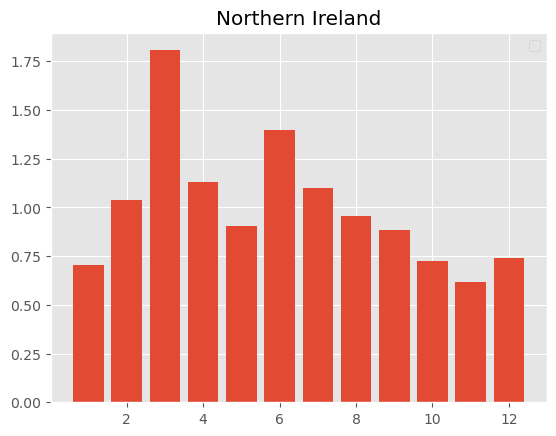

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Singapore nbr tot reviews 349


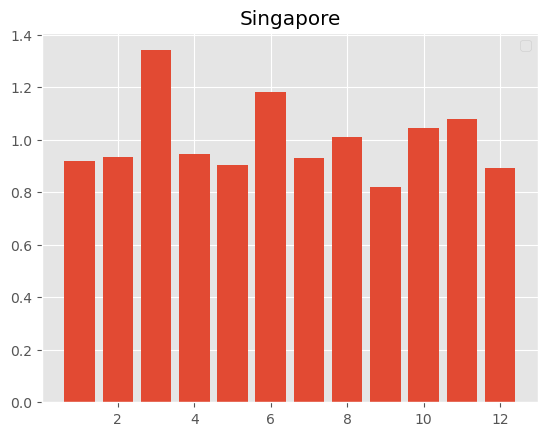

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


China nbr tot reviews 666


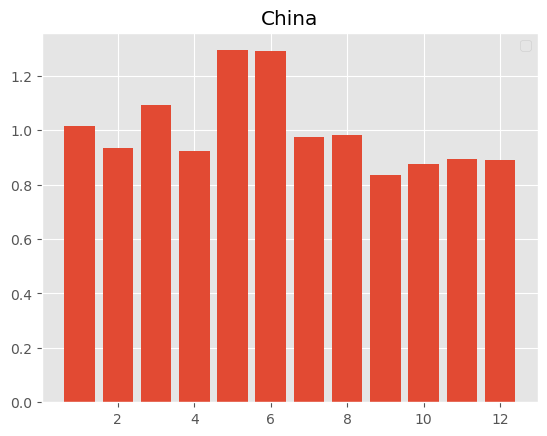

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Romania nbr tot reviews 1224


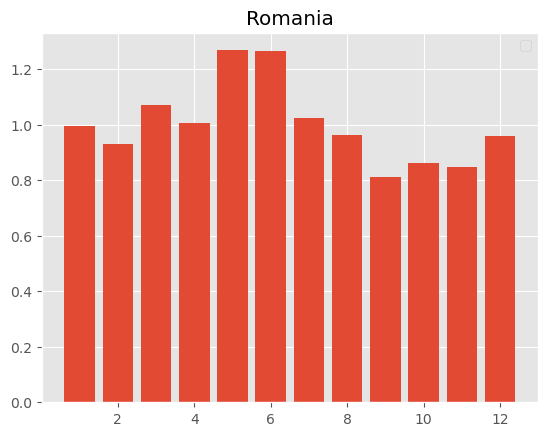

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Croatia nbr tot reviews 1724


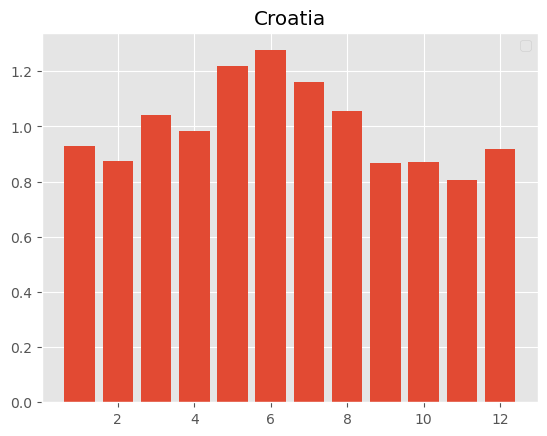

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Mexico nbr tot reviews 2093


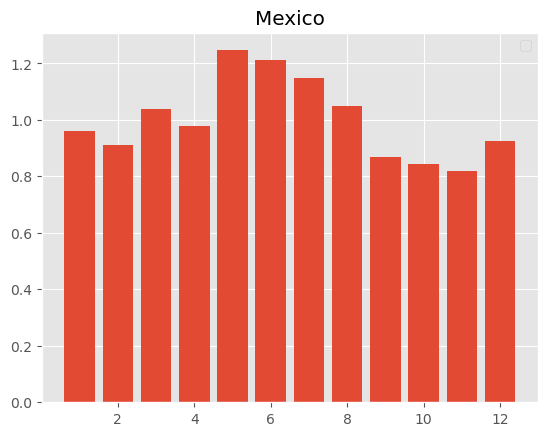

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Ukraine nbr tot reviews 842


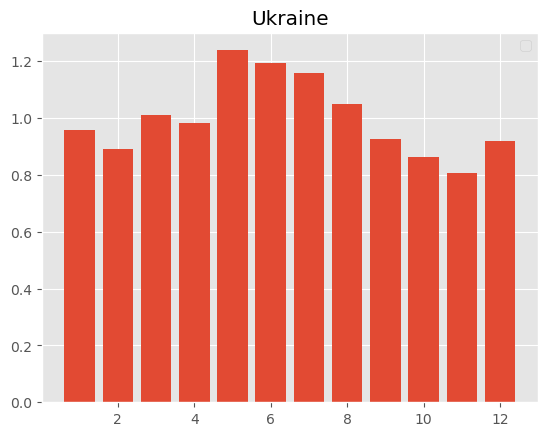

pas de pic pour Canada
pas de pic pour Portugal
pas de pic pour India
pas de pic pour Japan
pas de pic pour Hungary
pas de pic pour Bulgaria
pas de pic pour Lithuania
pas de pic pour Italy
pas de pic pour Denmark
pas de pic pour Greece
pas de pic pour Sri Lanka
pas de pic pour Germany
pas de pic pour Switzerland
pas de pic pour Israel
pas de pic pour El Salvador
pas de pic pour Chile
pas de pic pour Trinidad & Tobago
pas de pic pour Dominican Republic
pas de pic pour Wales
pas de pic pour Russia
pas de pic pour Australia
pas de pic pour Argentina
pas de pic pour Luxembourg
pas de pic pour Spain
pas de pic pour Belarus
pas de pic pour Austria
pas de pic pour Brazil
pas de pic pour Vietnam
pas de pic pour New Zealand
pas de pic pour Turkey
pas de pic pour South Africa
pas de pic pour Czech Republic
pas de pic pour Faroe Islands
pas de pic pour Netherlands
pas de pic pour Peru
pas de pic pour Slovenia
pas de pic pour Serbia
pas de pic pour Latvia
pas de pic pour Finland
pas de pic pour Sw

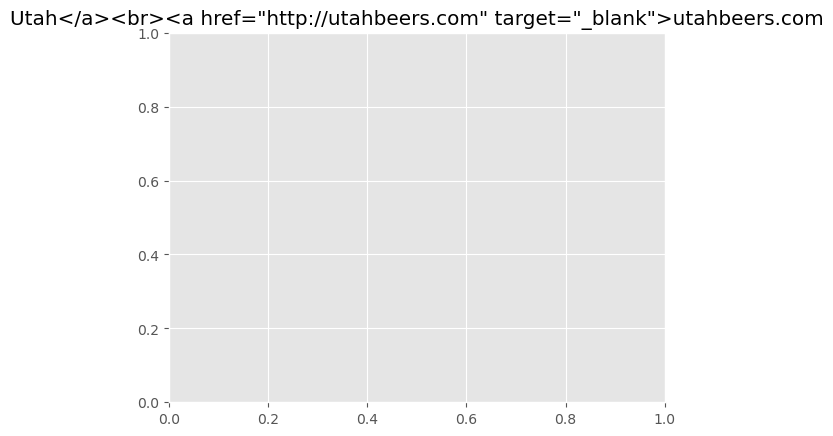

In [93]:
#Trying to plot every location that have a peak in the number of reviews during a certains month of the year.
tableau = np.zeros(12)
for loca in total_ratings_breweries.groupby("location").filter(lambda x: len(x) >= 500).location.unique():
    review_loca = total_ratings_breweries[(total_ratings_breweries["location"] == loca)]
    tot_reviews = review_loca.shape[0]
    if tot_reviews >2000:

        plt.title(loca)
        for year in range(2001, 2018):
        
            years_data = total_ratings_breweries[(total_ratings_breweries["location"] == loca) & (total_ratings_breweries["date_datetime"].dt.year == year)]
            tot_reviews = years_data.shape[0]
            
            if tot_reviews == 0:
            
                tot_reviews = 1
            if tot_reviews > 500:

                for i in range(1,13):
                    if i in years_data["datetime_month"].value_counts().index:
                        tableau[i-1]+=(years_data["datetime_month"].value_counts()[i]/tot_reviews)
                
        moy=np.mean(tableau)
        tab_mean=tableau/moy
        if np.any(tab_mean>1.2):
            print(loca, "nbr tot reviews", tot_reviews)
            plt.bar(range(1,13),tab_mean) 
            plt.legend()
            plt.show()
        else:
            print("pas de pic pour", loca)

#### Trending beer

                            beer_name  review_count  \
0            Founders Breakfast Stout         10233   
16509                   90 Minute IPA          9887   
32057                     Sculpin IPA          8737   
60197                    Heady Topper          8670   
98814      Bourbon County Brand Stout          7565   
172163           Arrogant Bastard Ale          7133   
172164                  60 Minute IPA          6928   
183516                    Zombie Dust          6866   
228394           St. Bernardus Abt 12          6651   
262269                       Ten FIDY          6119   
272132                La Fin Du Monde          5983   
310843  Weihenstephaner Hefeweissbier          5533   
329988                    Double Jack          5532   
330068                 West Coast IPA          5331   
330071                 West Coast IPA          5331   
330073                 West Coast IPA          5331   
337982                 West Coast IPA          5331   
337988    

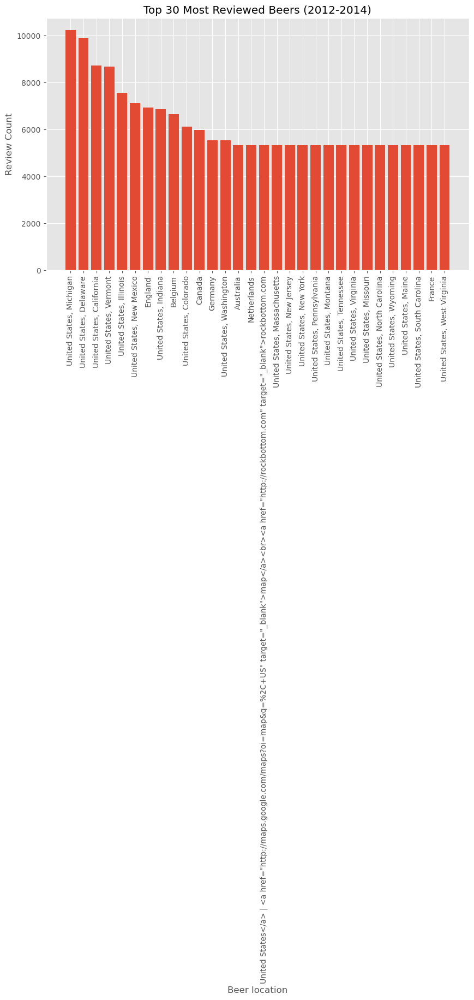

In [94]:
# Filter the dataframe
filtered_df = total_ratings_breweries[(total_ratings_breweries['date_datetime'].dt.year >= 2012) & (total_ratings_breweries['date_datetime'].dt.year <= 2014)]

# Group by beer name and count the reviews
beer_reviews = filtered_df.groupby('beer_name').size().reset_index(name='review_count')

# Sort the dataframe in descending order

sorted_reviews = beer_reviews.sort_values('review_count', ascending=False)
sorted_reviews_m = pd.merge(sorted_reviews, total_ratings_breweries[['beer_name', 'location']], on='beer_name', how='inner')
#  Select the top N beers
top_n = 30  # Change this value to select the desired number of top beers
top_beers = sorted_reviews_m.drop_duplicates(subset='location').head(top_n)
print (top_beers)
# Plot the top beers
plt.figure(figsize=(10, 6))
plt.bar(top_beers['location'], top_beers['review_count'])
plt.xlabel('Beer location')
plt.ylabel('Review Count')
plt.title('Top {} Most Reviewed Beers (2012-2014)'.format(top_n))
plt.xticks(rotation=90)
plt.show()

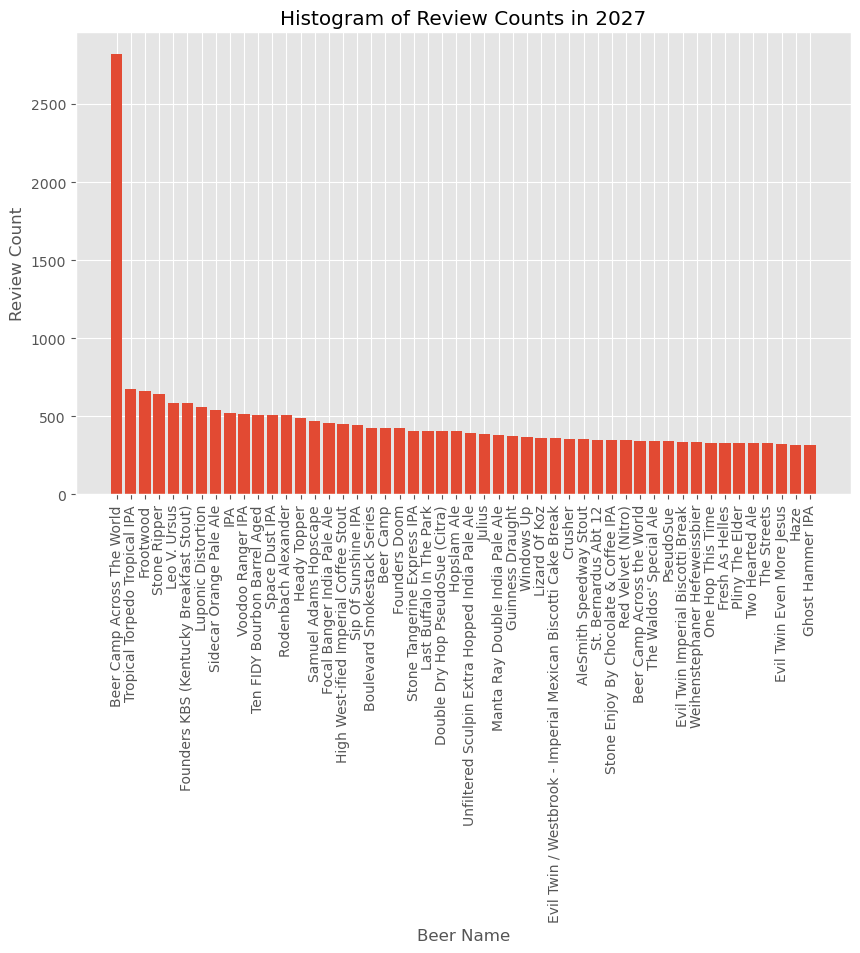

Beer with the most reviews in 2027: beer_name       Beer Camp Across The World
review_count                          2818
Name: 17019, dtype: object
sdwd
                            beer_name  review_count
17019      Beer Camp Across The World          2818
169983  Tropical Torpedo Tropical IPA           672
65472                       Frootwood           660
156757                   Stone Ripper           641
98861                    Leo V. Ursus           585
...                               ...           ...
84360     Illuminated Pazuzus Pedals             1
84359     Illuminated Orange Sunshine             1
84358          Illuminated Hasselhopf             1
84357         Illuminated Frozen Mind             1
186105                             爱啤             1

[186106 rows x 2 columns]


In [95]:
# Filter the dataframe for 2017
df_2027 = total_ratings_breweries[total_ratings_breweries['date_datetime'].dt.year == 2017]

# Group by beer name and count the reviews
beer_reviews_2027 = df_2027.groupby('beer_name').size().reset_index(name='review_count')

#  Sort the dataframe in descending order based on review count
sorted_reviews_2027 = beer_reviews_2027.sort_values('review_count', ascending=False)

plt.figure(figsize=(10, 6))
plt.bar(sorted_reviews_2027['beer_name'][0:50], sorted_reviews_2027['review_count'][0:50])
plt.xlabel('Beer Name')
plt.ylabel('Review Count')
plt.title('Histogram of Review Counts in 2027')
plt.xticks(rotation=90)
plt.show()

#  Select the beer with the highest review count
beer_with_most_reviews_2027 = sorted_reviews_2027.iloc[0]

print("Beer with the most reviews in 2027:", beer_with_most_reviews_2027)
print("sdwd")
print(sorted_reviews_2027)

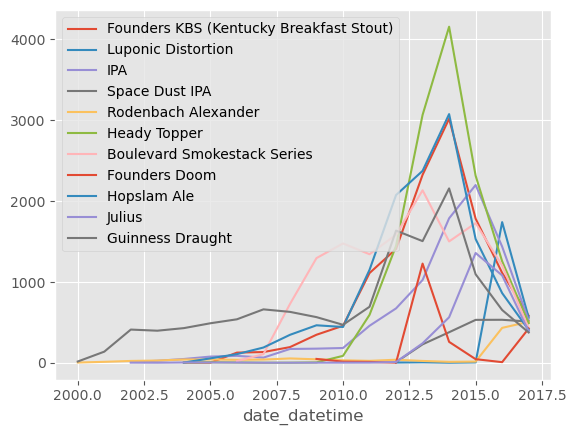

In [96]:
top_30_beers_2027 = sorted_reviews_2027.head(30)
#  Plot the number of reviews for each year
for beer in (top_30_beers_2027['beer_name']):
    beer_data = total_ratings_breweries[total_ratings_breweries['beer_name'] == beer]
    if beer_data.groupby(beer_data['date_datetime'].dt.year)['date_datetime'].count().shape[0]>=5:
        beer_data.groupby(beer_data['date_datetime'].dt.year)['date_datetime'].count().plot(label=beer)
        plt.legend()

In [97]:
# Step 1: Filter the dataframe
filtered_df = total_ratings_breweries[(total_ratings_breweries['date_datetime'].dt.year >= 2012) & (total_ratings_breweries['date_datetime'].dt.year <= 2014)]

# Step 2: Group by beer name and count the reviews
beer_reviews = filtered_df.groupby('beer_name').size().reset_index(name='review_count')

# Step 3: Sort the dataframe in descending order

sorted_reviews = beer_reviews.sort_values('review_count', ascending=False)
sorted_reviews_m = pd.merge(sorted_reviews, total_ratings_breweries[['beer_name', 'location']], on='beer_name', how='inner')
# Step 4: Select the top N beers
top_n = 30  # Change this value to select the desired number of top beers
top_beers = sorted_reviews_m.drop_duplicates(subset='location').head(top_n)
print (top_beers)

                            beer_name  review_count  \
0            Founders Breakfast Stout         10233   
16509                   90 Minute IPA          9887   
32057                     Sculpin IPA          8737   
60197                    Heady Topper          8670   
98814      Bourbon County Brand Stout          7565   
172163           Arrogant Bastard Ale          7133   
172164                  60 Minute IPA          6928   
183516                    Zombie Dust          6866   
228394           St. Bernardus Abt 12          6651   
262269                       Ten FIDY          6119   
272132                La Fin Du Monde          5983   
310843  Weihenstephaner Hefeweissbier          5533   
329988                    Double Jack          5532   
330068                 West Coast IPA          5331   
330071                 West Coast IPA          5331   
330073                 West Coast IPA          5331   
337982                 West Coast IPA          5331   
337988    

In [98]:
# Step 1: Group the dataframe by beer name and year, and count the reviews
beer_reviews = total_ratings_breweries.groupby(['beer_name', total_ratings_breweries['date_datetime'].dt.year]).size().reset_index(name='review_count')

# Step 2: Calculate the total number of reviews for each year
yearly_reviews = total_ratings_breweries.groupby(total_ratings_breweries['date_datetime'].dt.year).size().reset_index(name='total_reviews_by_year')

# Step 3: Calculate the total number of review for each beer name
beer_tot_reviews = total_ratings_breweries.groupby(total_ratings_breweries['beer_name']).size().reset_index(name='total_reviews_by_beer')

In [99]:
yearly_reviews.head(30)

,date_datetime,total_reviews_by_year
0,1996,1
1,1998,134
2,1999,83
3,2000,2804
4,2001,20388
5,2002,99557
6,2003,163937
7,2004,229261
8,2005,298465
9,2006,380197


In [100]:
beer_reviews[beer_reviews["beer_name"]== "Heady Topper"] 


,beer_name,date_datetime,review_count
619239,Heady Topper,2004,3
619240,Heady Topper,2005,7
619241,Heady Topper,2007,1
619242,Heady Topper,2008,1
619243,Heady Topper,2009,5
619244,Heady Topper,2010,86
619245,Heady Topper,2011,593
619246,Heady Topper,2012,1447
619247,Heady Topper,2013,3066
619248,Heady Topper,2014,4157


In [101]:
print(yearly_reviews.shape)
print(beer_reviews.shape)
print(beer_tot_reviews.shape)


(21, 2)
(1520254, 3)
(588258, 2)


In [102]:
beer_reviews_yearly = pd.merge(beer_reviews, yearly_reviews, on='date_datetime', how='left')
beer_reviews_yearly_tot=pd.merge(beer_reviews_yearly,beer_tot_reviews, on='beer_name',how='left')
print(beer_reviews_yearly.shape)
print(beer_reviews_yearly_tot.shape)

(1520254, 4)
(1520254, 5)


In [103]:
beer_reviews_yearly_tot[beer_reviews_yearly_tot["beer_name"]== "Heady Topper"]

,beer_name,date_datetime,review_count,total_reviews_by_year,total_reviews_by_beer
619239,Heady Topper,2004,3,229261,13426
619240,Heady Topper,2005,7,298465,13426
619241,Heady Topper,2007,1,485981,13426
619242,Heady Topper,2008,1,595145,13426
619243,Heady Topper,2009,5,638204,13426
619244,Heady Topper,2010,86,668738,13426
619245,Heady Topper,2011,593,982421,13426
619246,Heady Topper,2012,1447,1469490,13426
619247,Heady Topper,2013,3066,2017924,13426
619248,Heady Topper,2014,4157,2698255,13426


In [104]:
beer_reviews_yearly_tot_location = pd.merge(beer_reviews_yearly_tot, total_ratings_breweries[['beer_name', 'location']], on='beer_name', how='left')

print(beer_reviews_yearly_tot_location.shape)

(143360363, 6)


In [105]:
beer_reviews_yearly_tot_location=beer_reviews_yearly_tot_location.drop_duplicates(subset=['beer_name','date_datetime'])
print(beer_reviews_yearly_tot_location.shape)

(1520254, 6)


In [106]:
beer_reviews_yearly_tot_location_sorted = beer_reviews_yearly_tot_location.sort_values('total_reviews_by_beer', ascending=False)


In [119]:
most_reviewed_beer=beer_reviews_yearly_tot_location_sorted.drop_duplicates(subset='beer_name')
top100_most_reviewed_beer=most_reviewed_beer.head(30)


In [120]:
top100_most_reviewed_beer['beer_name'].value_counts()


Founders Breakfast Stout                         1
90 Minute IPA                                    1
Ten FIDY                                         1
La Fin Du Monde                                  1
Zombie Dust                                      1
Brooklyn Black Chocolate Stout                   1
Budweiser                                        1
Ayinger Celebrator Doppelbock                    1
Sierra Nevada Celebration Ale                    1
Lagunitas Sucks (Brown Shugga Substitute Ale)    1
Stone Enjoy By IPA                               1
Stone Ruination IPA                              1
Sierra Nevada Torpedo Extra IPA                  1
Stone IPA (India Pale Ale)                       1
Sierra Nevada Pale Ale                           1
60 Minute IPA                                    1
Weihenstephaner Hefeweissbier                    1
Bourbon County Brand Stout                       1
Old Rasputin Russian Imperial Stout              1
Founders KBS (Kentucky Breakfas

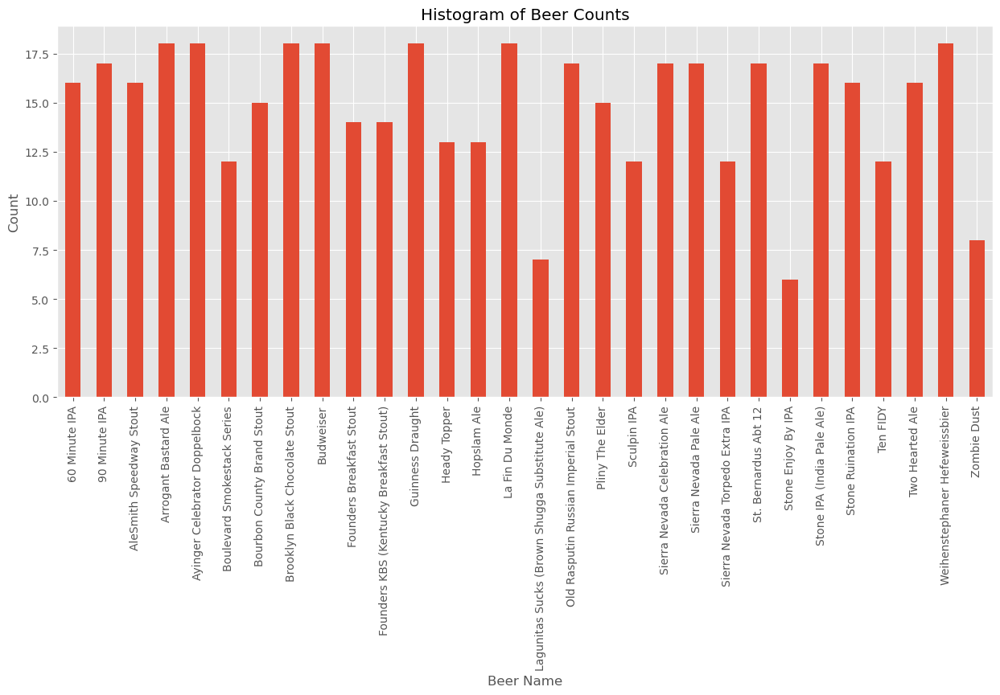

In [121]:
group_counts = beer_reviews_yearly_tot_location_sorted[beer_reviews_yearly_tot_location_sorted['beer_name'].isin(top100_most_reviewed_beer['beer_name'])].groupby('beer_name').size()
group_counts.plot.bar(figsize=(15, 6))
plt.xlabel('Beer Name')
plt.ylabel('Count')
plt.title('Histogram of Beer Counts')
plt.xticks(rotation=90)
plt.show()